In [1]:
%matplotlib inline

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from datetime import datetime
from datetime import timezone

from math import cos, radians

In [2]:
def plot_TMA():
    TMA_lon=[12.4975, 13.1639, 13.3244, 13.3244, 13.2769, 13.1992, 12.6958, 11.7661, 11.5828, 11.1406, 11.4503, 12.2956,
         11.9975, 12.4975];


    TMA_lat=[58.7661, 58.7328, 58.5169, 58.2953, 58.0969, 57.7672, 57.2275, 56.9856, 57.2136, 57.7514, 58.1278, 58.6456,
         58.4653, 58.7661];

    rwy03_lon=[12.26771, 12.29193];
    rwy03_lat=[57.64952, 57.67615 ];
    
    KELIN_lon =    12.0542
    KELIN_lat =    58.2436
    LOBBI_lon =    11.4981
    LOBBI_lat =    57.3181
    MAKUR_lon =    11.4069
    MAKUR_lat =    57.4297
    MOXAM_lon =    13.3139
    MOXAM_lat =    58.5314
    NEGIL_lon =    12.6253
    NEGIL_lat =    58.2513
    RISMA_lon =    11.9792
    RISMA_lat =    57.0419
    ARQUS_lon =    12.9286
    ARQUS_lat =    57.0958
    
    fig, ax = plt.subplots(1, 1,figsize=(10,10))
    
    central_latitude = min(TMA_lat) + (max(TMA_lat)-min(TMA_lat))/2
    #print(central_latitude)
    # calculate the aspect ratio that will approximate a 
    # Mercator projection at this central latitude 
    mercator_aspect_ratio = 1/cos(radians(central_latitude))

    # set the aspect ratio of the axes to that
    ax.set_aspect(mercator_aspect_ratio)

    plt.xlabel('Longitude', fontsize=25)
    plt.ylabel('Latitude', fontsize=25)  
    
    plt.tick_params(labelsize=15)
    
    plt.plot(TMA_lon, TMA_lat, color="blue")
    plt.plot(rwy03_lon,rwy03_lat, color="red")
  
    plt.plot(KELIN_lon, KELIN_lat, 'ro')
    plt.plot(LOBBI_lon, LOBBI_lat, 'ro')
    plt.plot(MAKUR_lon, MAKUR_lat, 'ro')
    plt.plot(MOXAM_lon, MOXAM_lat, 'ro')
    plt.plot(NEGIL_lon, NEGIL_lat, 'ro')
    plt.plot(RISMA_lon, RISMA_lat, 'ro')
    plt.plot(ARQUS_lon, ARQUS_lat, 'ro')

In [3]:
 def plot_horizontal_profile(df, linewidth=1):
    
    plot_TMA()
    
    plt.xlim(11.2, 13.5)
    plt.ylim(57.0, 58.75)
    
    if df.empty:
        return
    
    for flight_id, flight_df in df.groupby(level='flightId'):
        #print(flight_id)
        flight_states_opensky_df = df.loc[(flight_id,), :]
        
        lons = flight_df["lon"]
        lats = flight_df["lat"]
        
        plt.plot(lons, lats, color='k', linewidth=linewidth)

In [4]:
def plot_vertical_profile(df, linewidth=1):
    
    for flight_id, flight_df in df.groupby(level='flightId'):
        flight_states_df = df.loc[(flight_id,), :]
        
        flight_states_df =flight_states_df.sort_index(level=['sequence'], ascending = False)
        
        if not flight_states_df.empty:

            opensky_states_altitudes = flight_df['altitude'].tolist()
            opensky_states_times = flight_df.index.get_level_values('sequence').tolist()
            
            plt.plot(opensky_states_times, opensky_states_altitudes, color='k', linewidth=linewidth)

# Data uploading

In [5]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_01_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_01_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_01_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_01_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_01_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

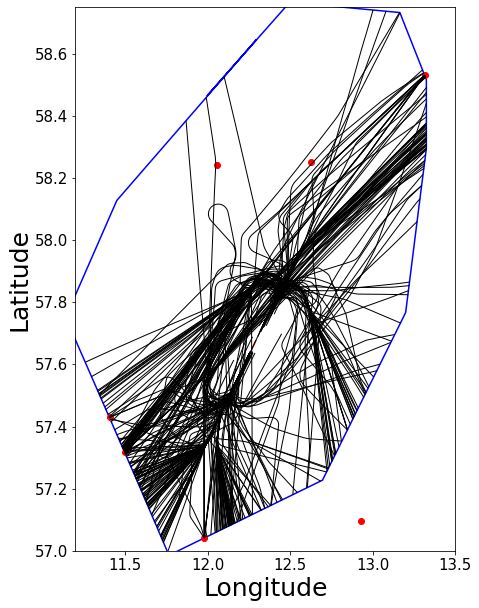

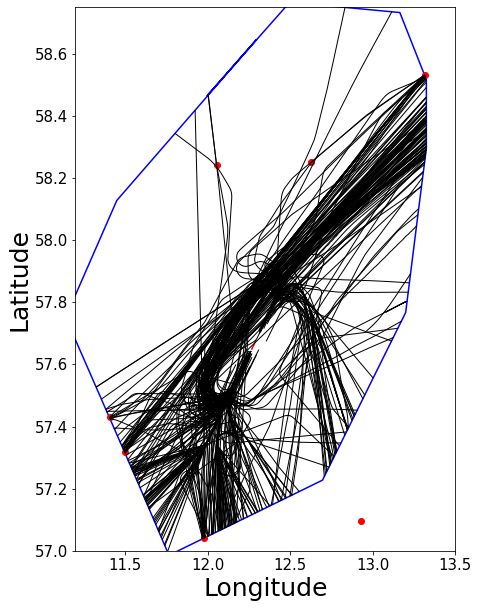

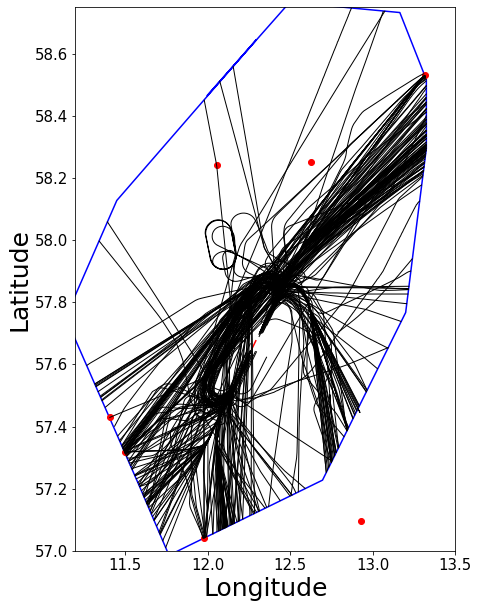

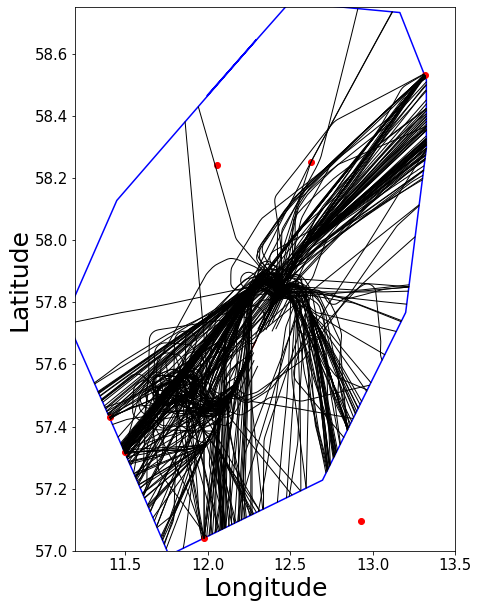

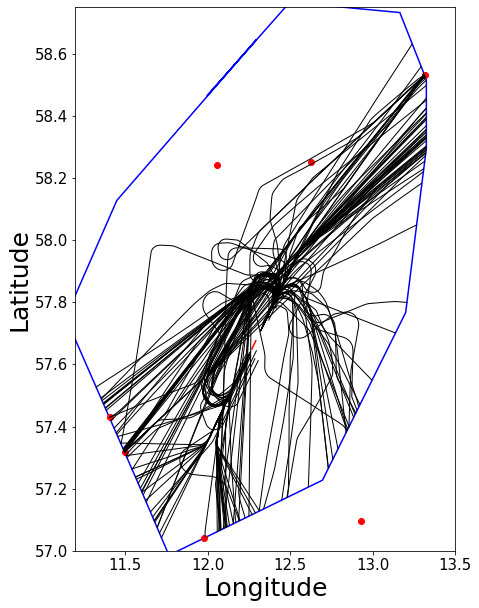

In [6]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_01_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_01_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_01_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_01_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_01_5.png")

In [7]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_02_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_02_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_02_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_02_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

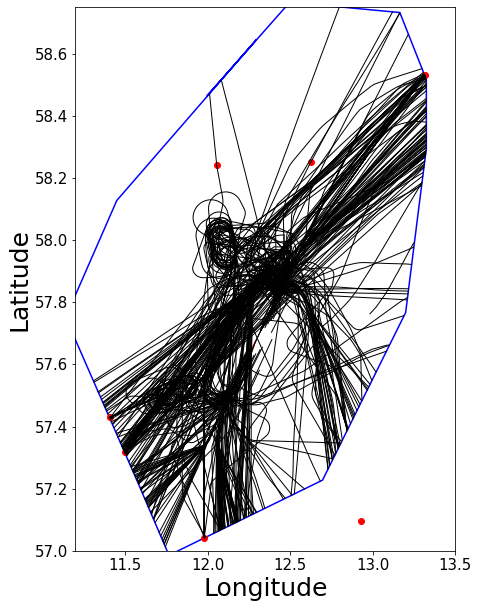

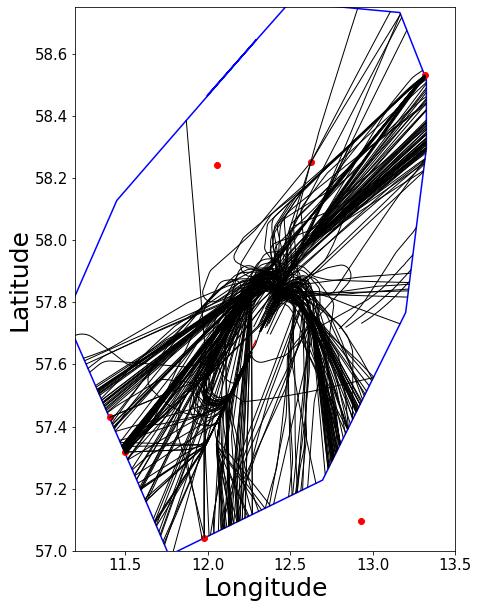

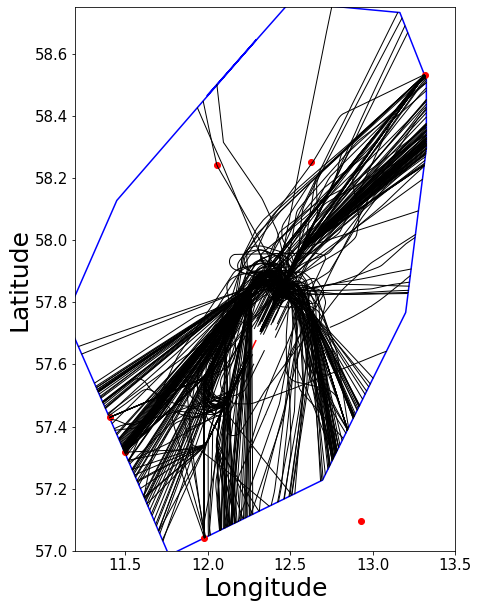

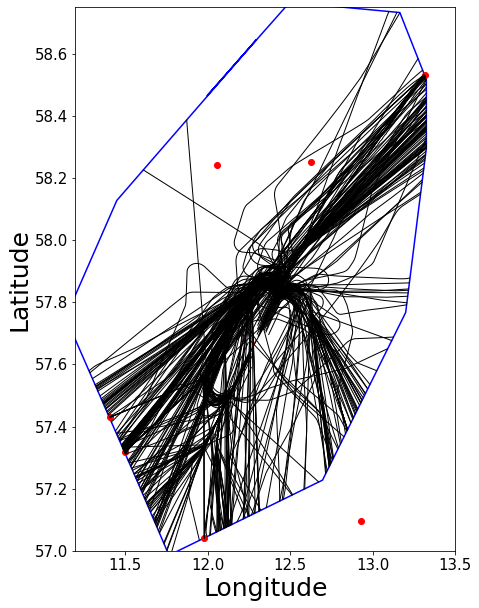

In [8]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_02_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_02_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_02_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_02_4.png")

In [9]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_03_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_03_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_03_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_03_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_03_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

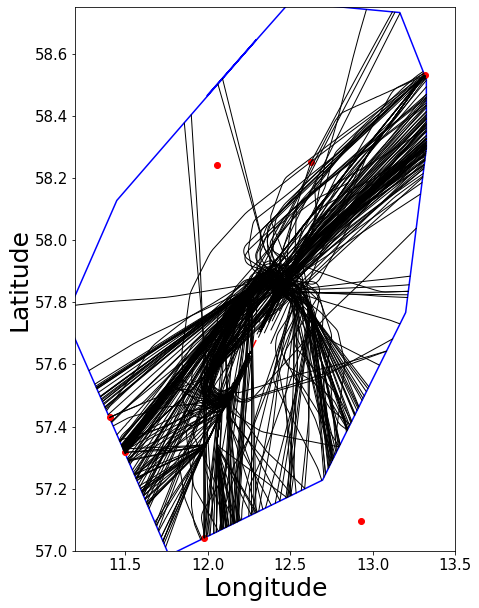

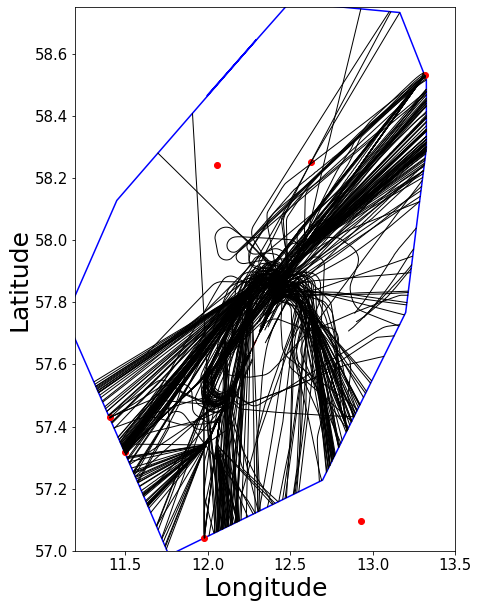

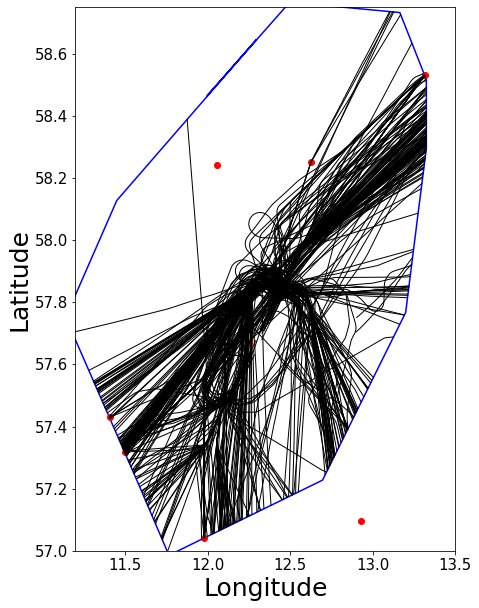

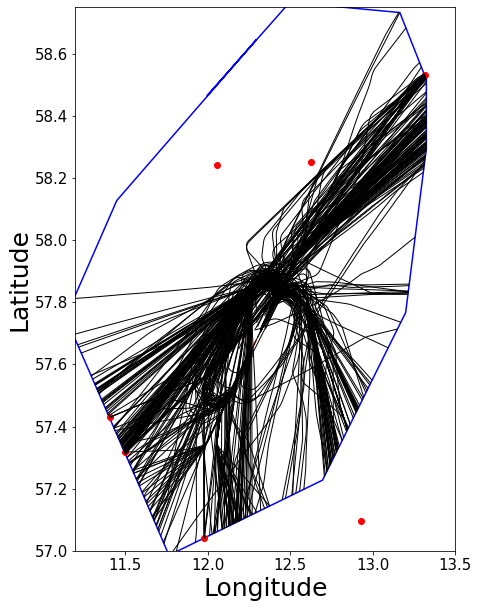

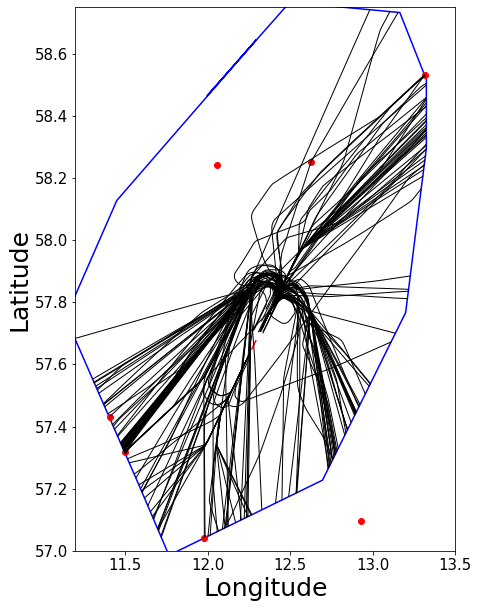

In [10]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_03_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_03_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_03_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_03_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_03_5.png")

In [11]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_04_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_04_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_04_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_04_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_04_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

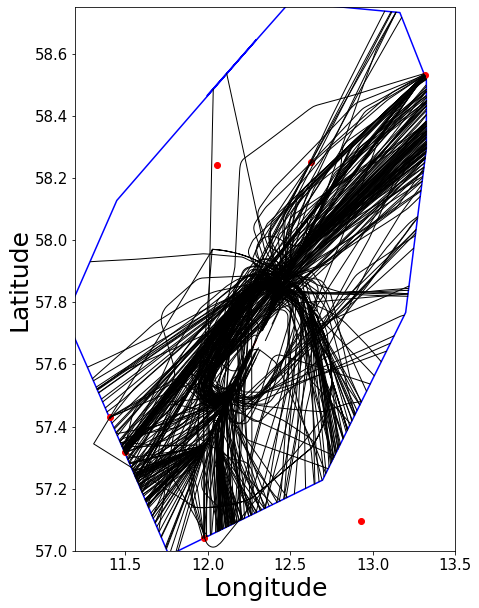

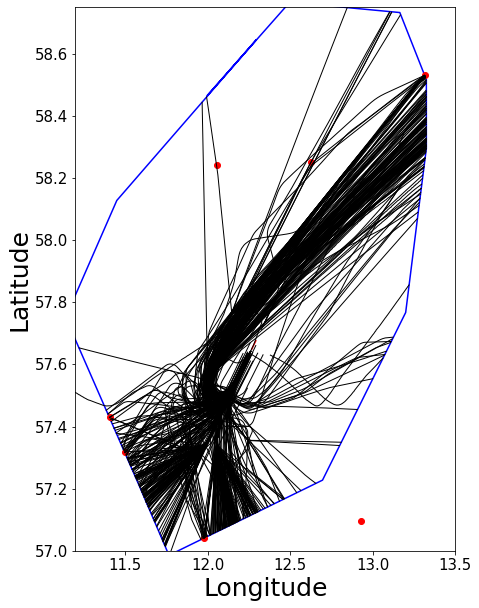

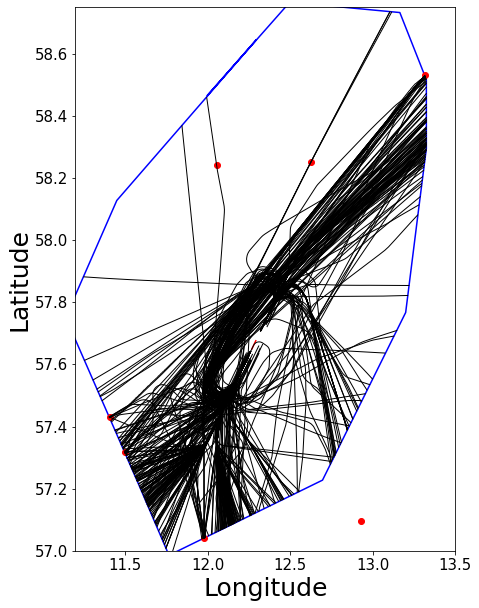

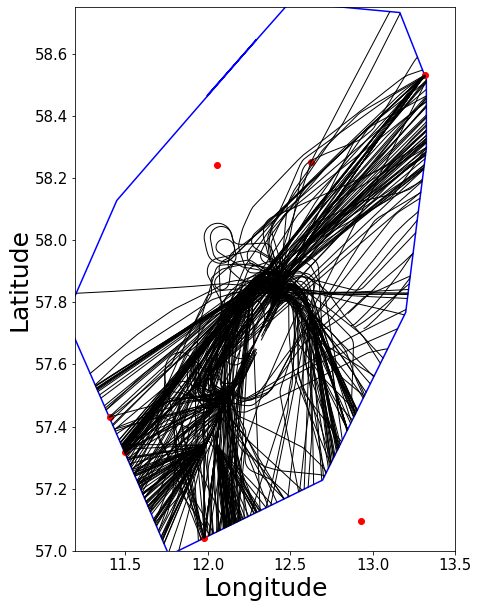

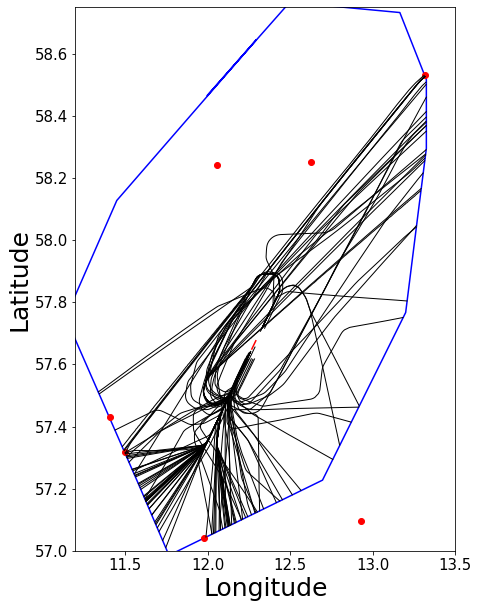

In [12]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_04_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_04_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_04_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_04_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_04_5.png")

In [13]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_05_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_05_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_05_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_05_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_05_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

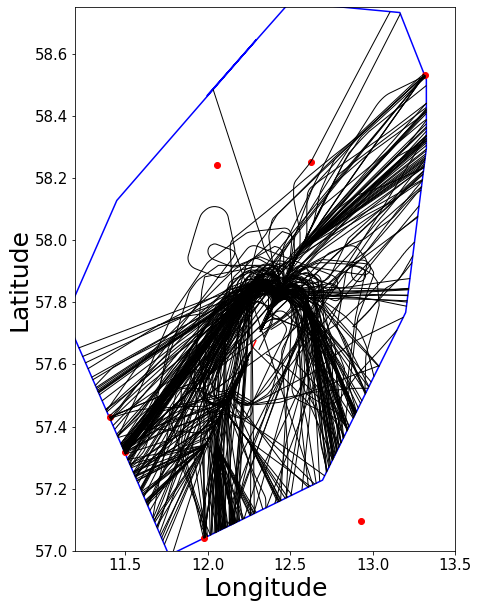

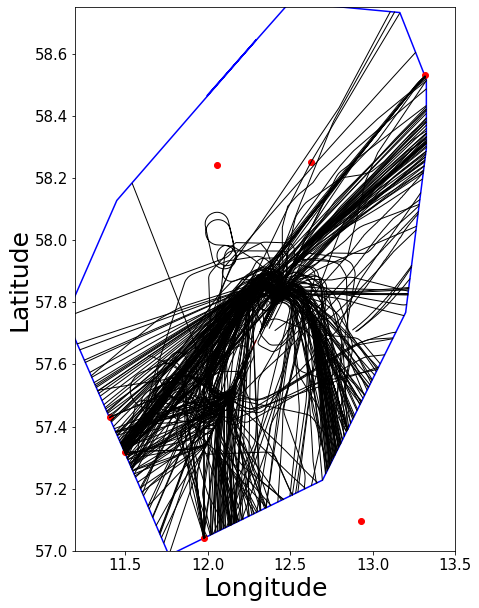

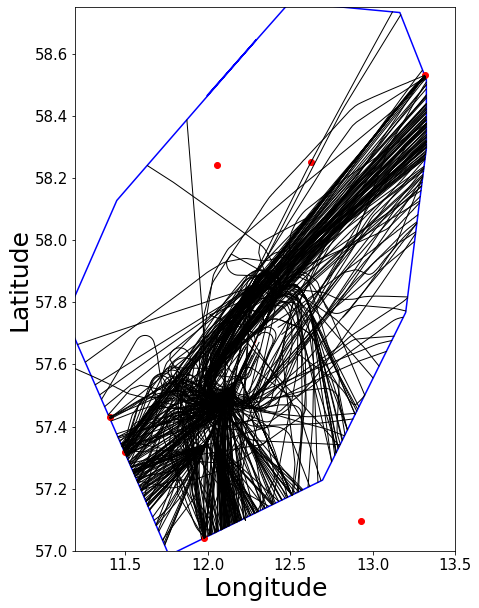

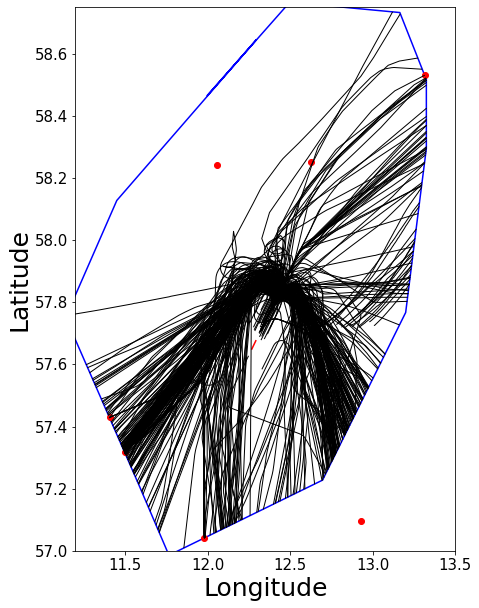

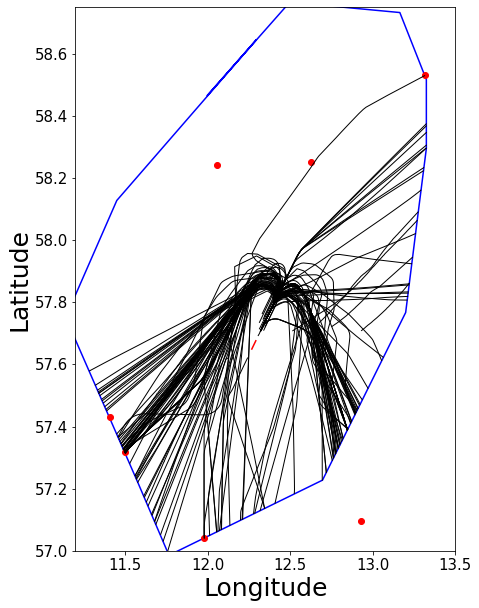

In [14]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_05_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_05_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_05_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_05_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_05_5.png")

In [15]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_06_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_06_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_06_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_06_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_06_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

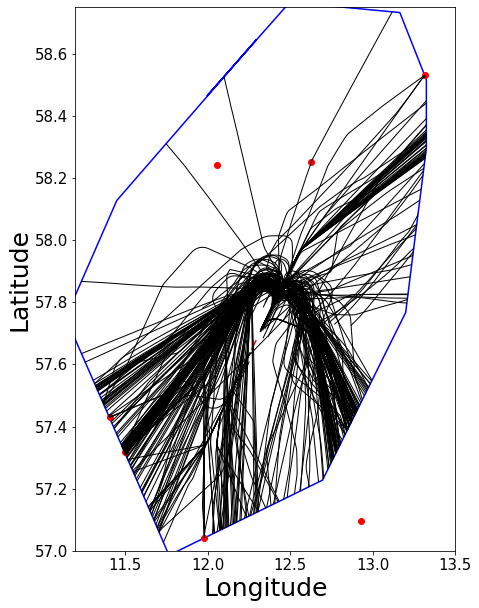

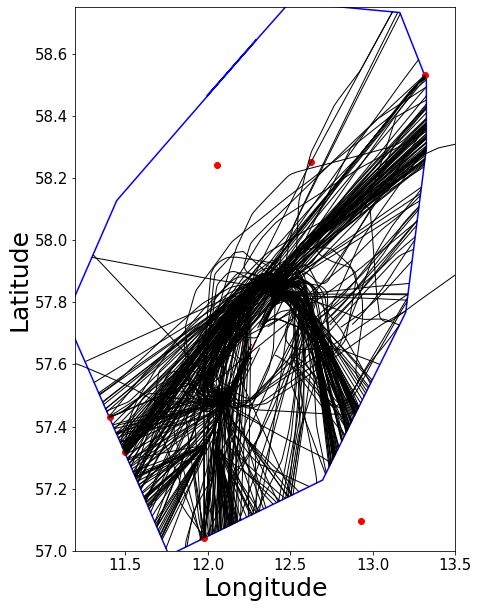

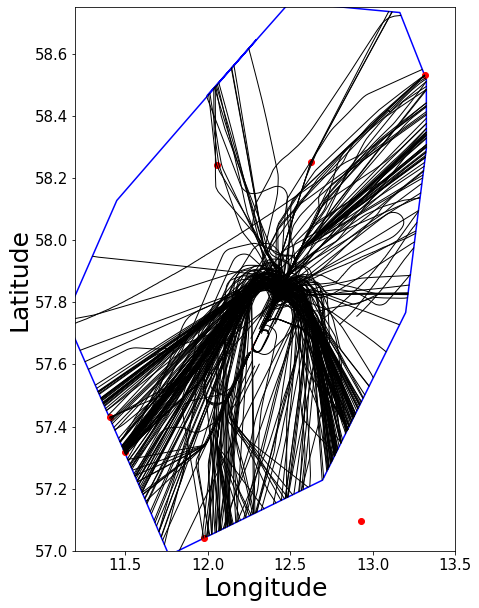

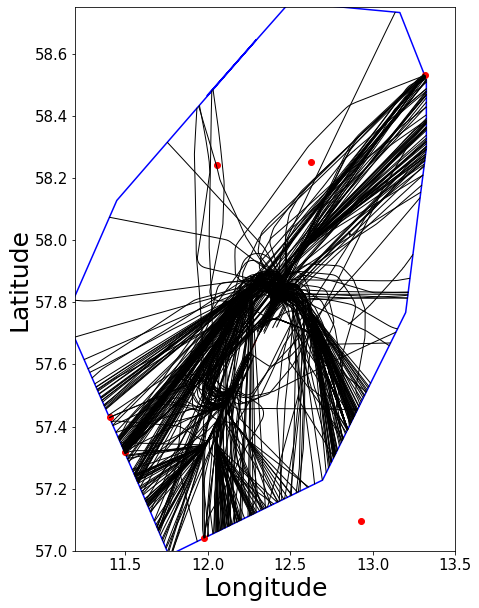

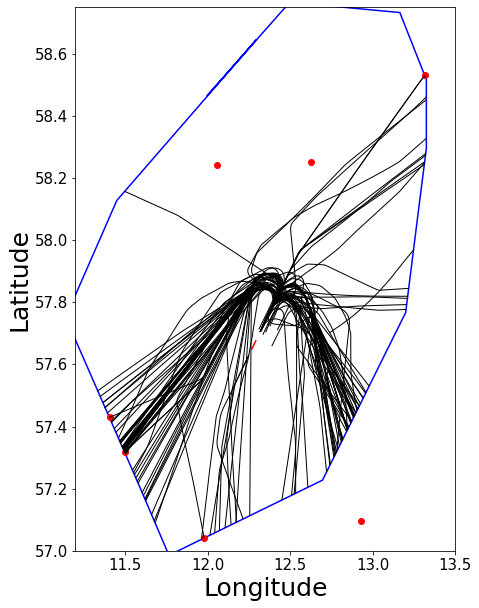

In [16]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_06_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_06_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_06_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_06_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_06_5.png")

In [17]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_07_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_07_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_07_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_07_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_07_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

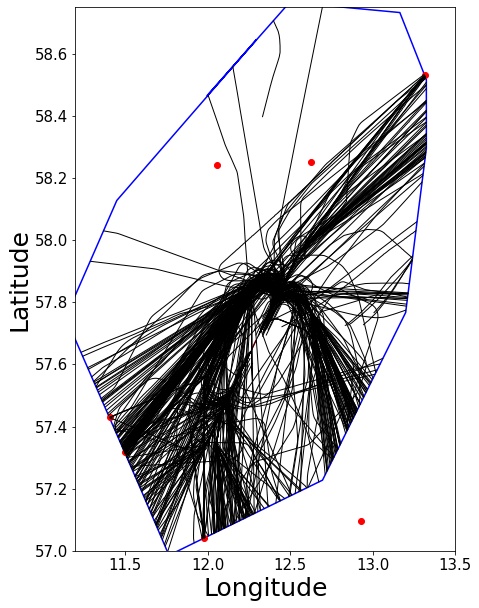

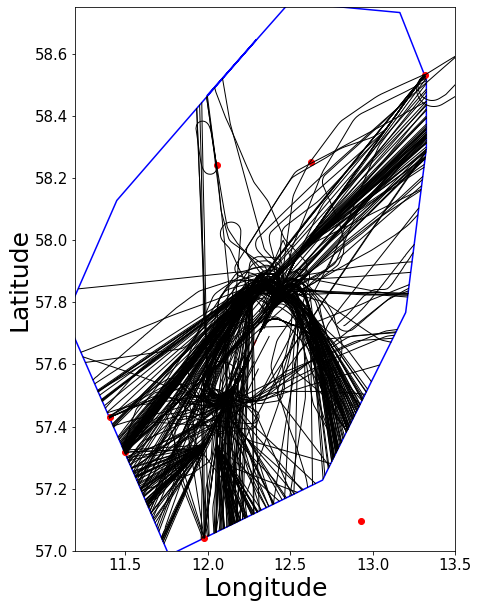

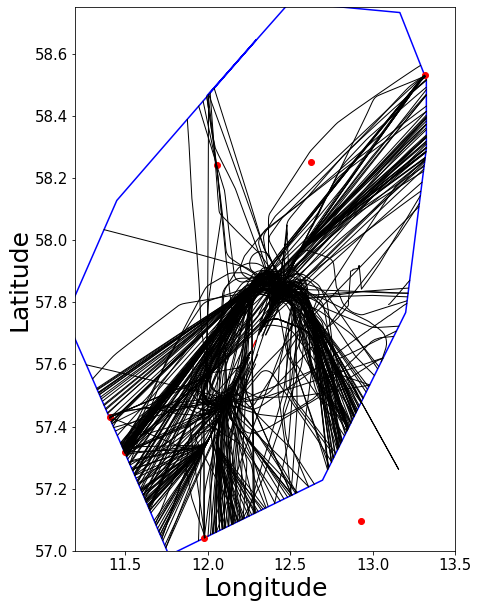

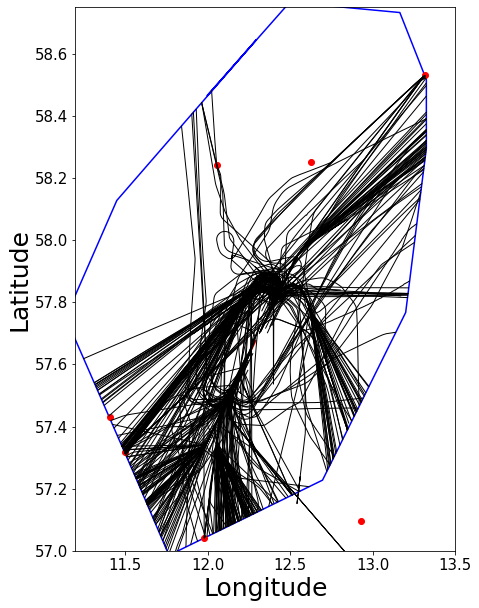

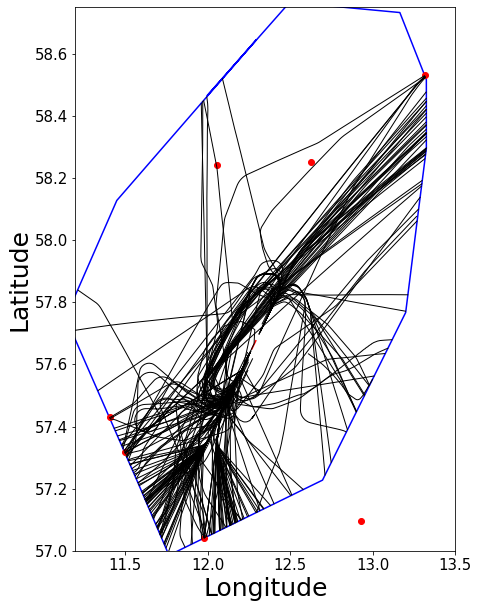

In [18]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_07_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_07_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_07_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_07_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_07_5.png")

In [19]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_08_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_08_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_08_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_08_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_08_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

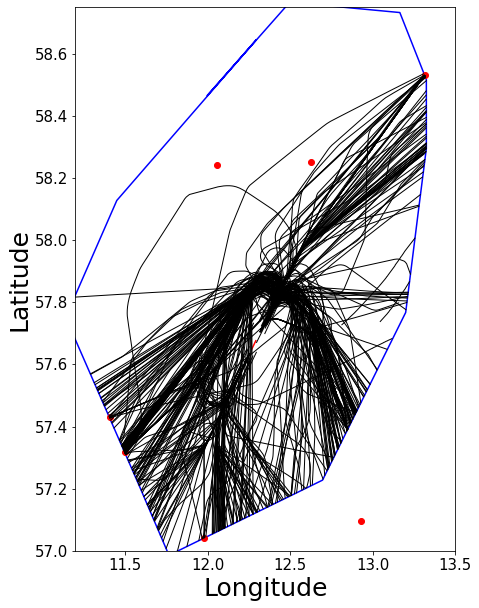

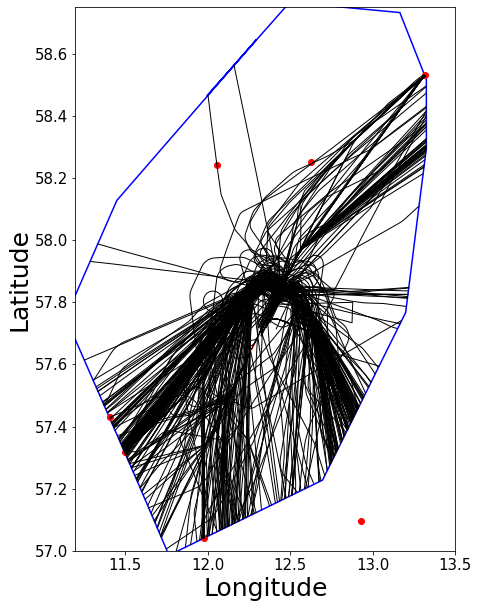

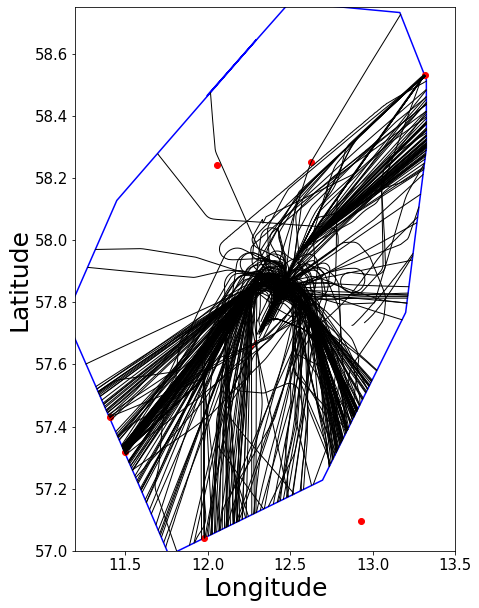

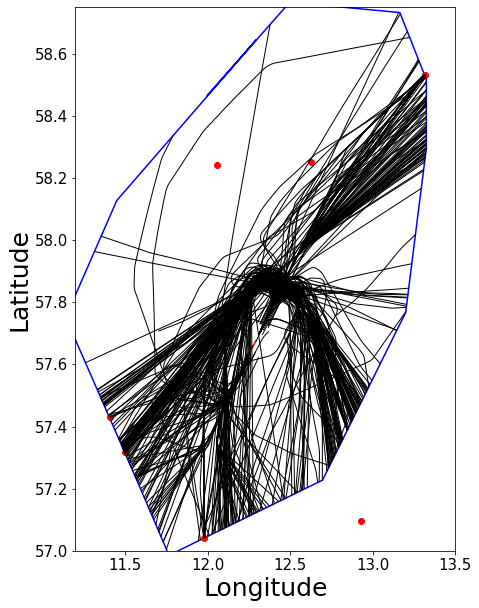

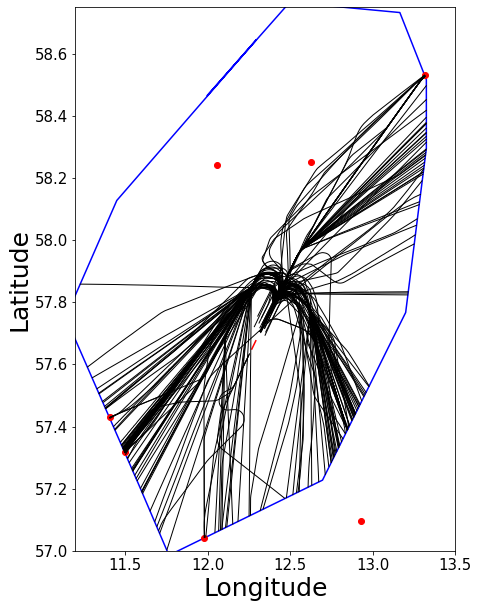

In [20]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_08_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_08_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_08_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_08_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_08_5.png")

In [21]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_09_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_09_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_09_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_09_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_09_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

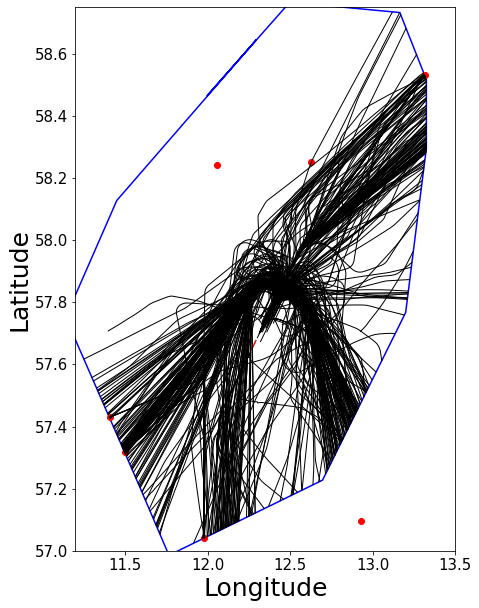

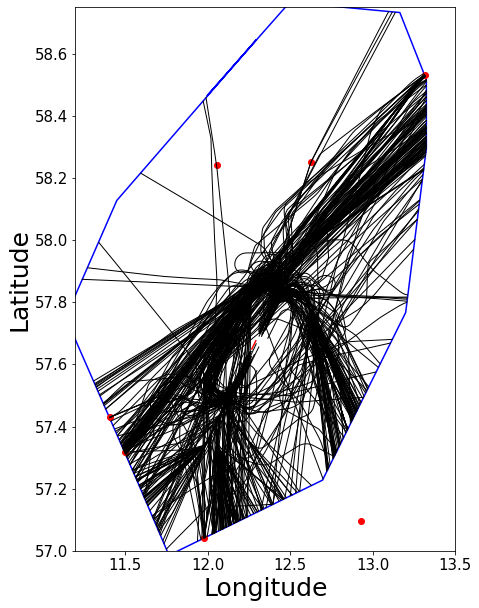

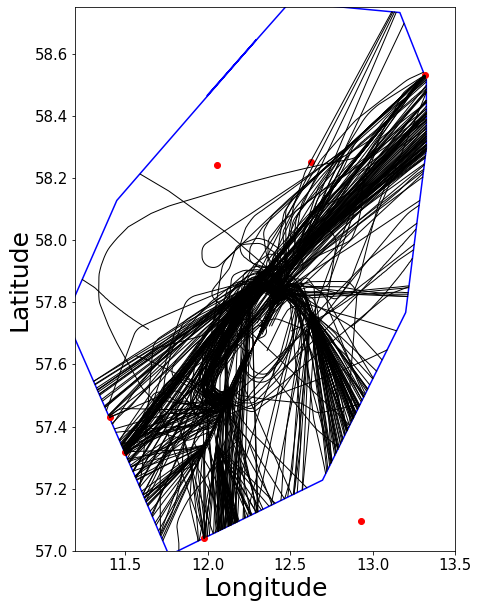

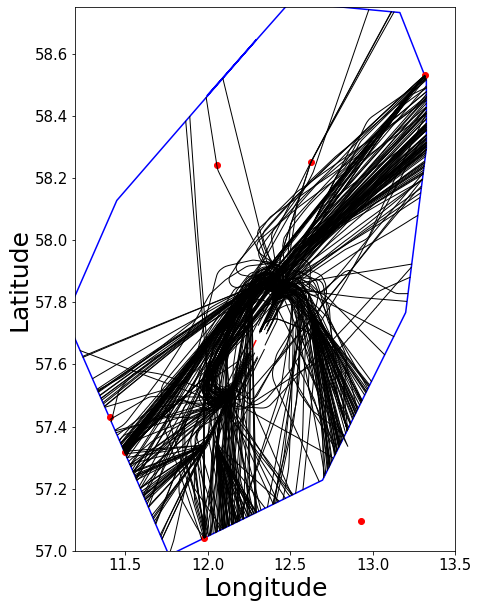

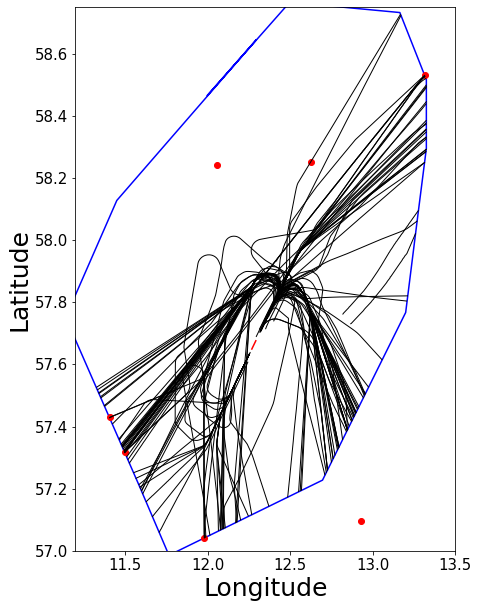

In [22]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_09_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_09_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_09_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_09_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_09_5.png")

In [23]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_10_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_10_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_10_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_10_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_10_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

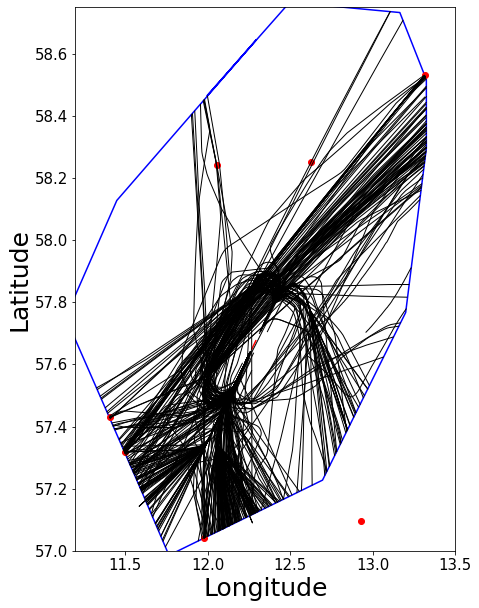

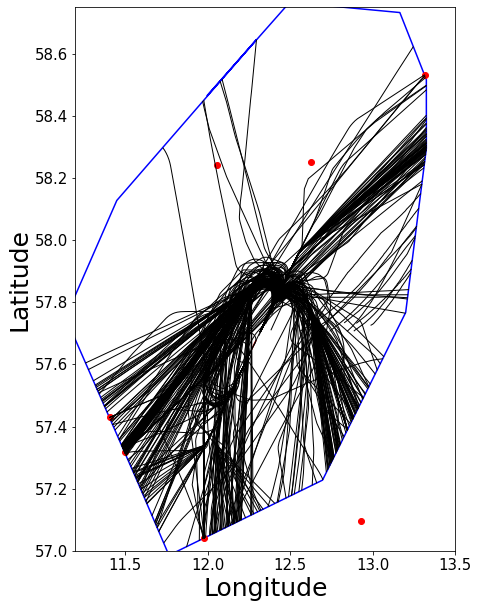

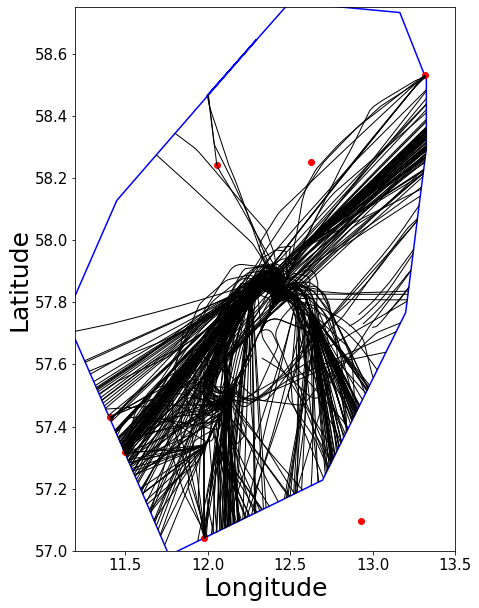

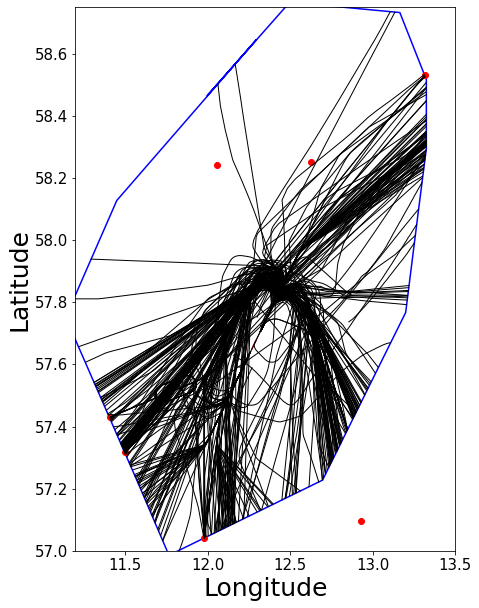

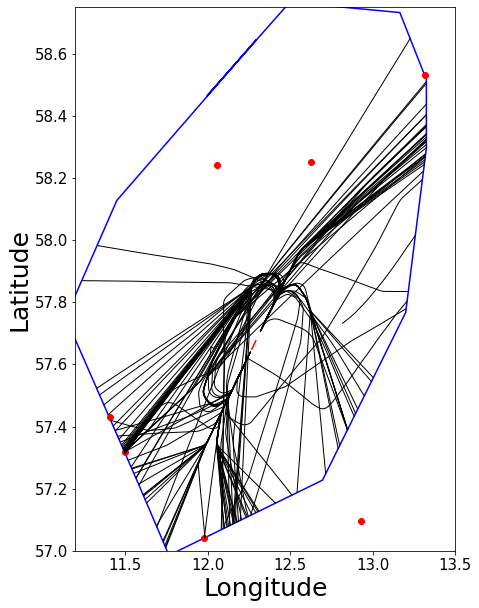

In [24]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_10_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_10_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_10_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_10_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_10_5.png")

In [25]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_11_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_11_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_11_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_11_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_11_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

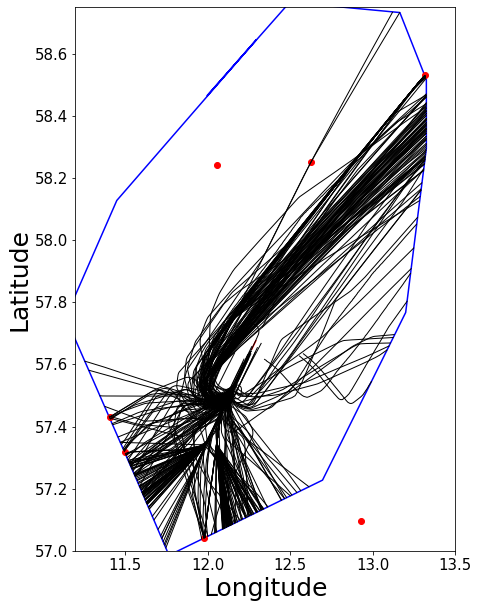

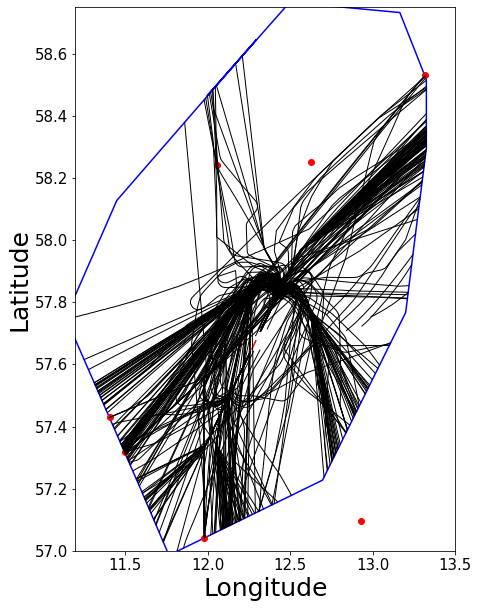

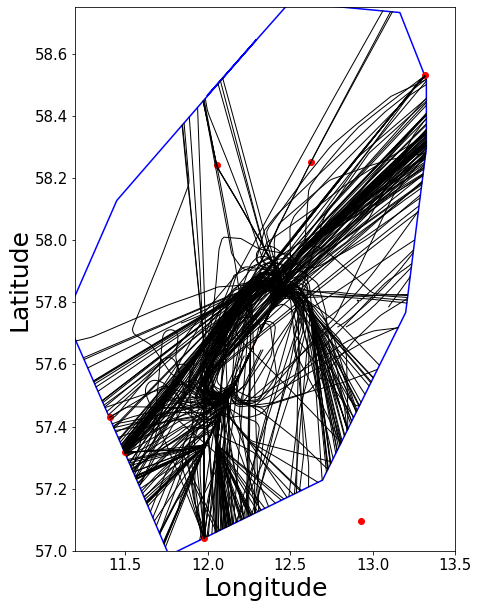

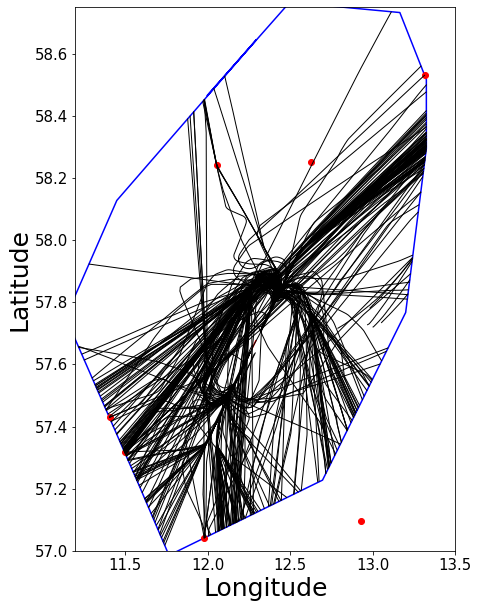

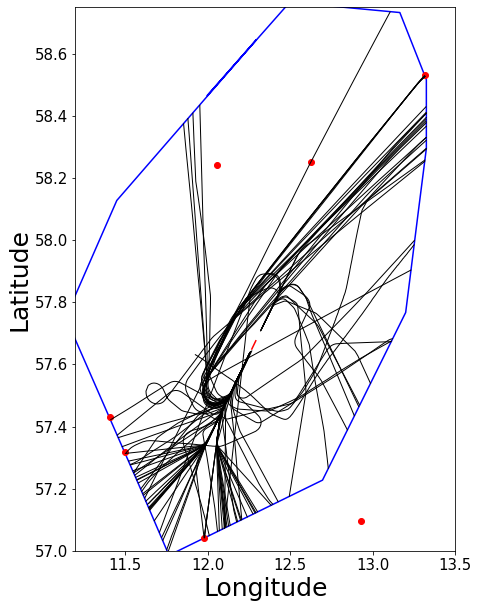

In [26]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_11_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_11_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_11_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_11_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_11_5.png")

In [27]:
filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_12_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_12_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_12_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_12_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2019/osn_ESGG_states_TMA_2019/osn_arrival_ESGG_states_TMA_2019_12_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

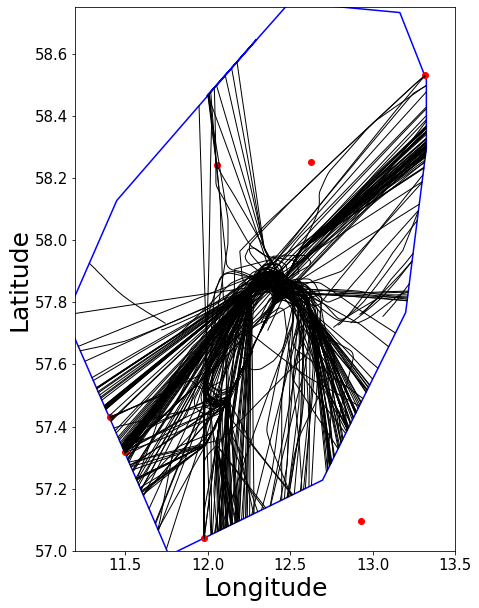

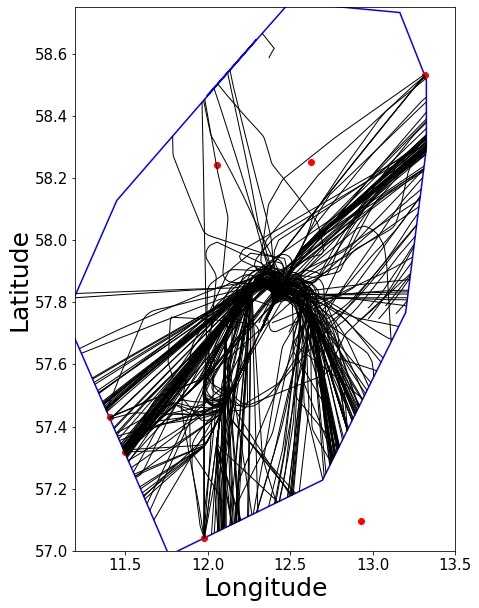

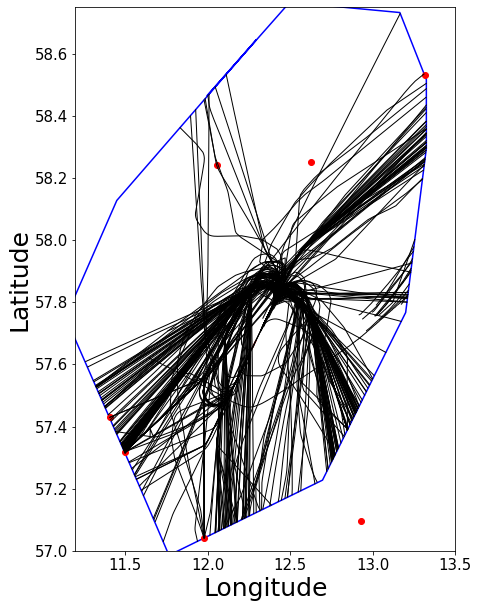

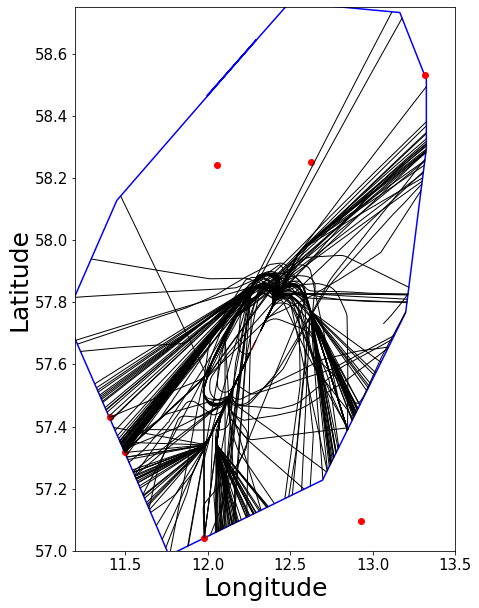

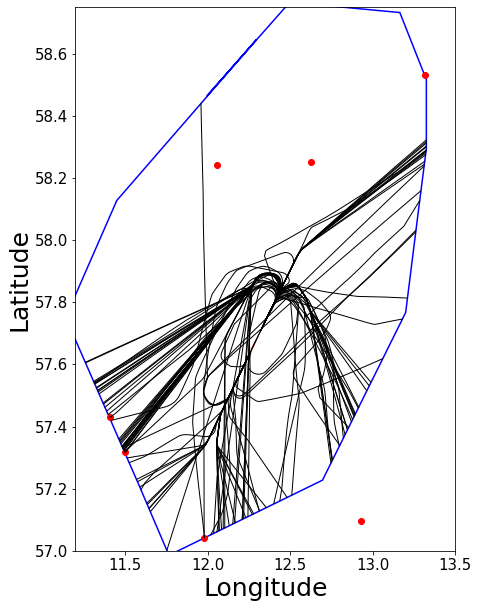

In [28]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2019_12_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2019_12_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2019_12_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2019_12_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2019_12_5.png")

In [29]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_01_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_01_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_01_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_01_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_01_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

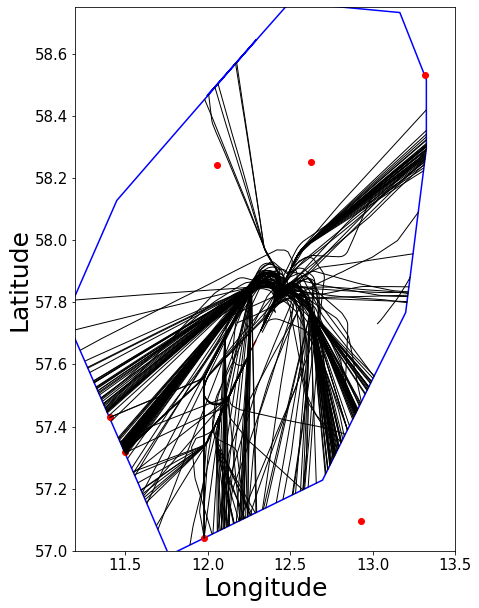

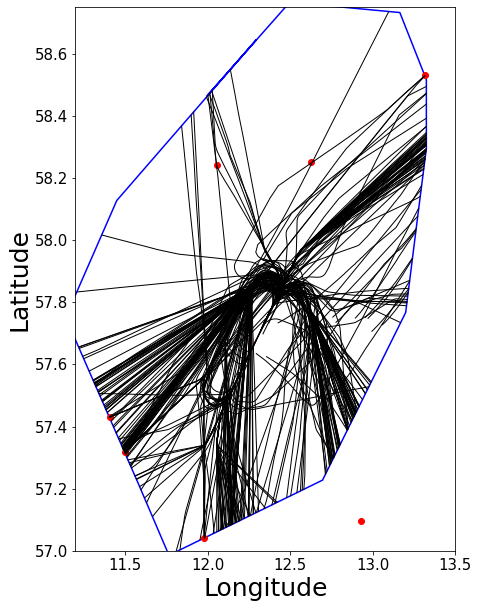

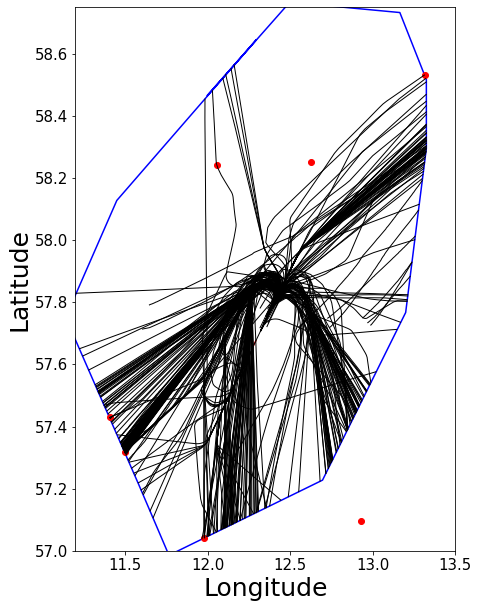

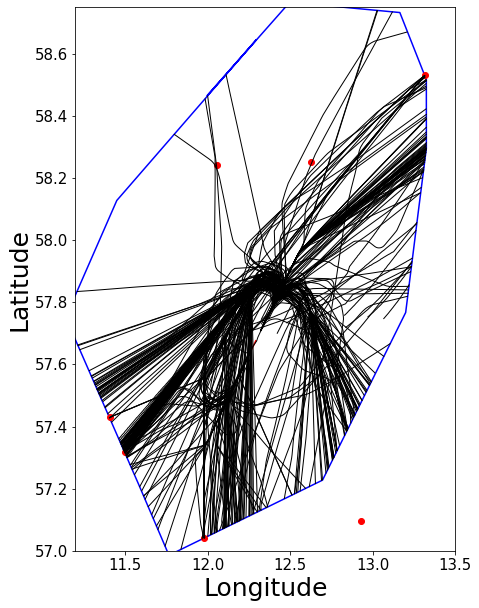

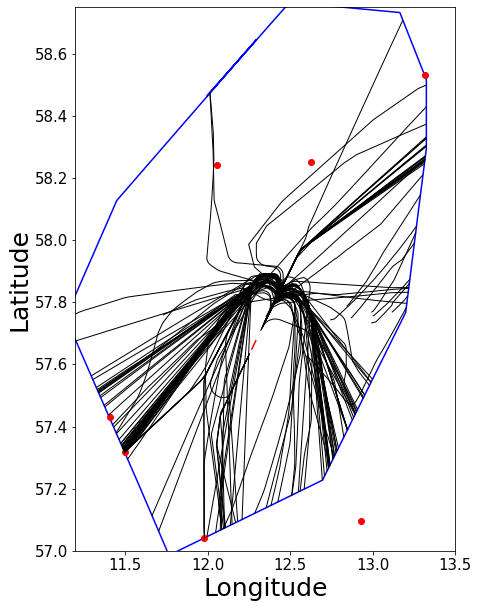

In [30]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_01_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_01_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_01_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_01_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_01_5.png")

In [31]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_02_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_02_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_02_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_02_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_02_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

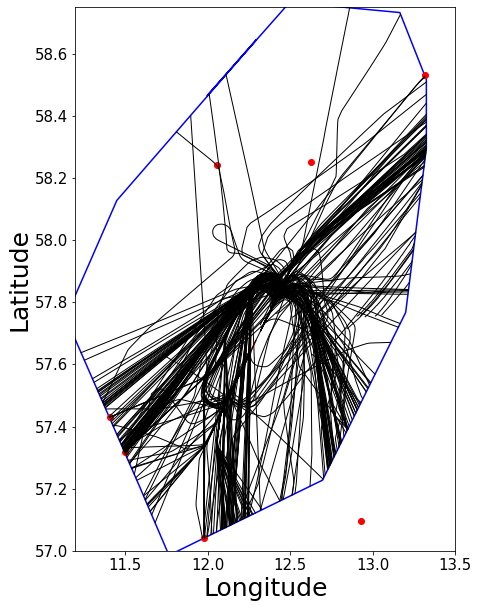

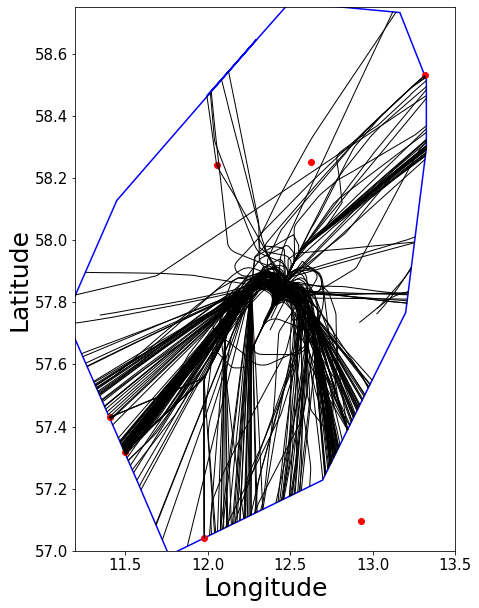

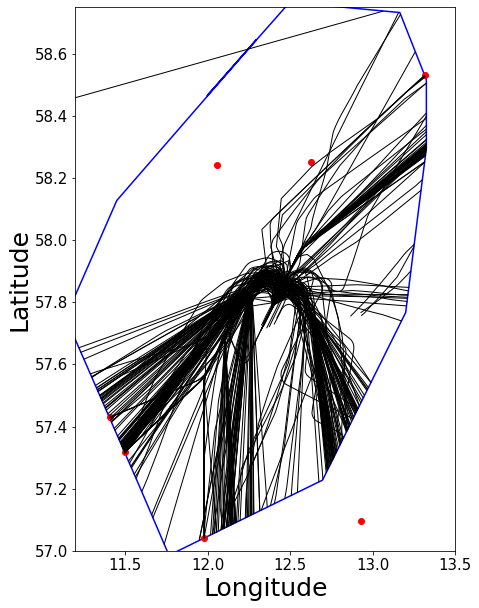

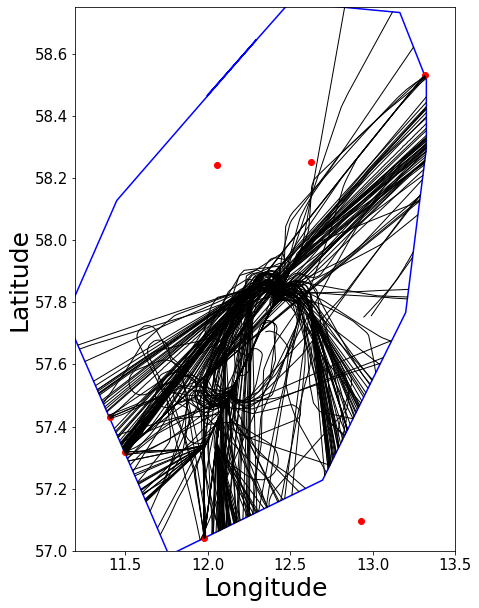

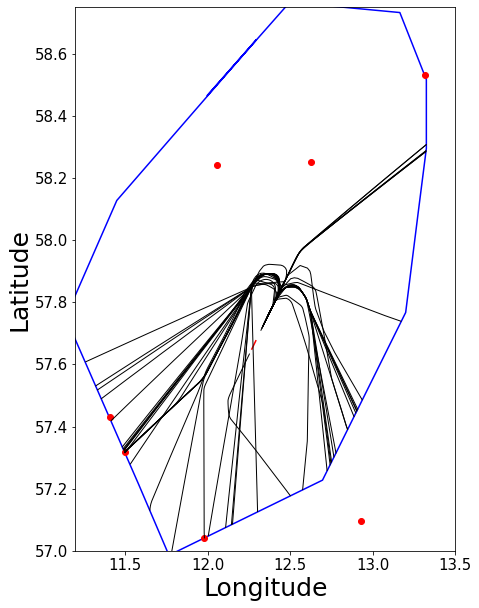

In [32]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_02_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_02_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_02_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_02_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_02_5.png")

In [33]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_03_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_03_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_03_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_03_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_03_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

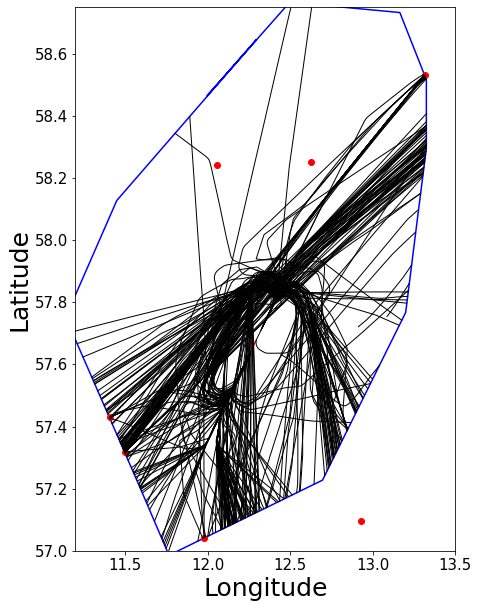

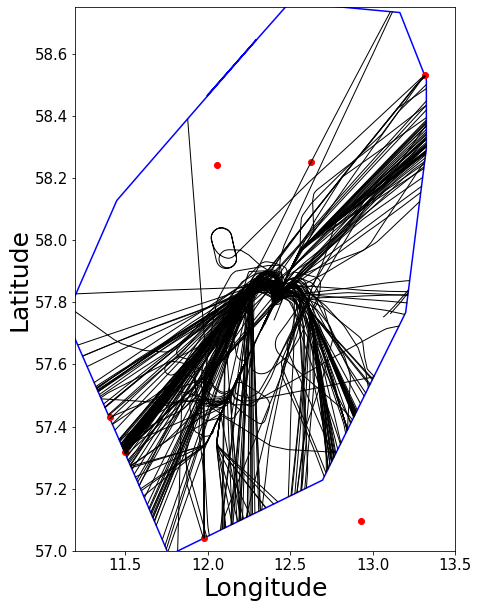

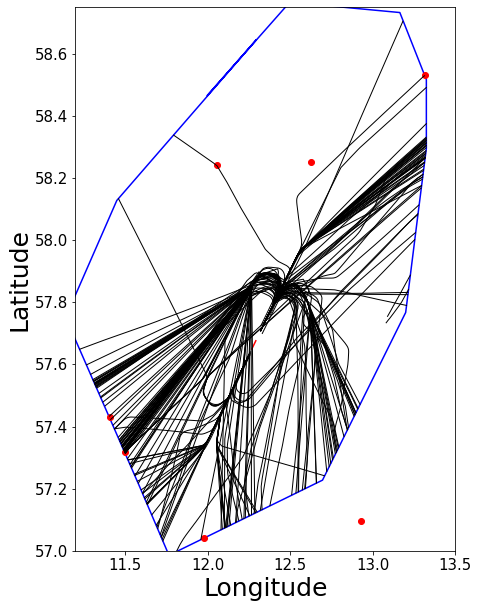

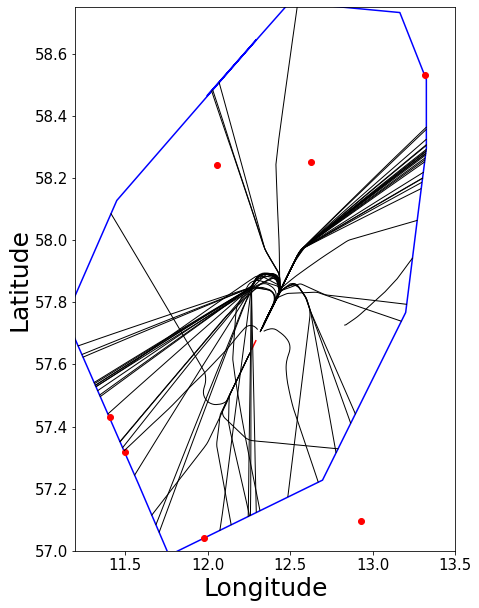

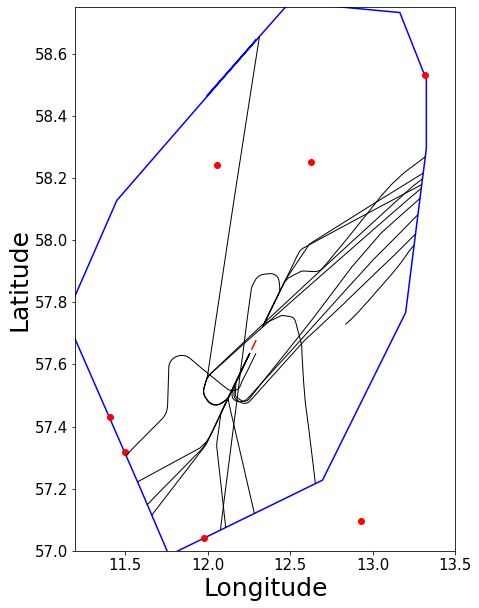

In [34]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_03_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_03_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_03_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_03_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_03_5.png")

In [35]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_04_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_04_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_04_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_04_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_04_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

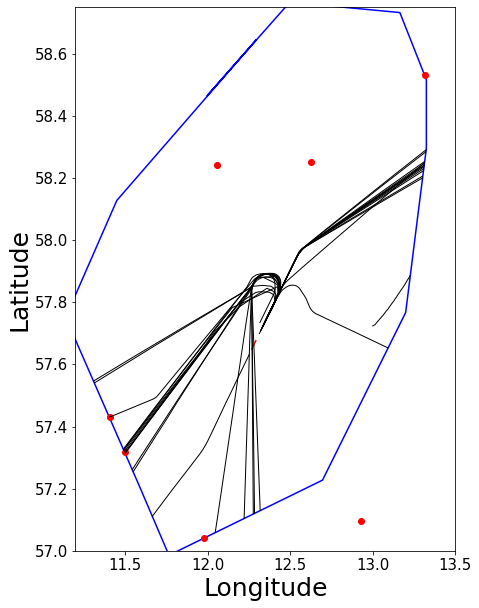

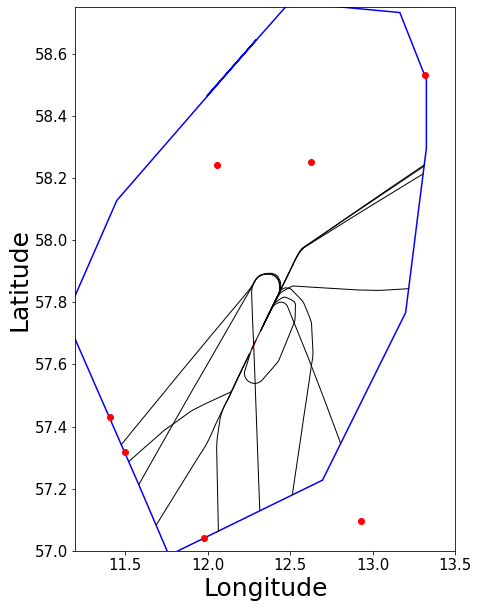

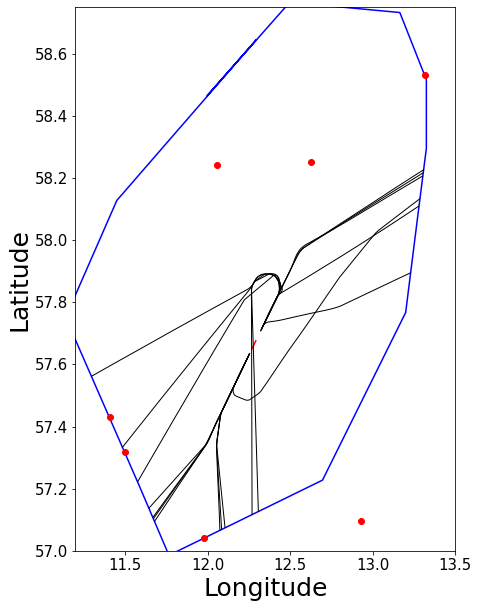

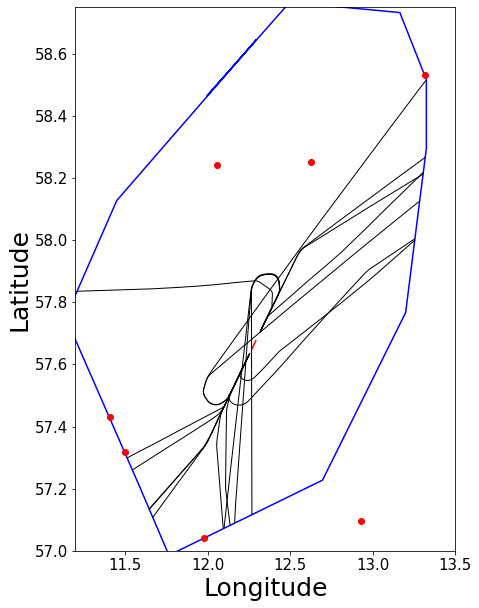

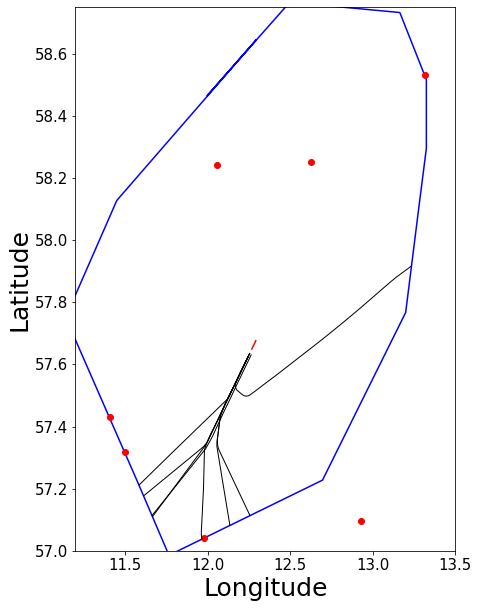

In [36]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_04_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_04_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_04_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_04_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_04_5.png")

In [37]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_05_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_05_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_05_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_05_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_05_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

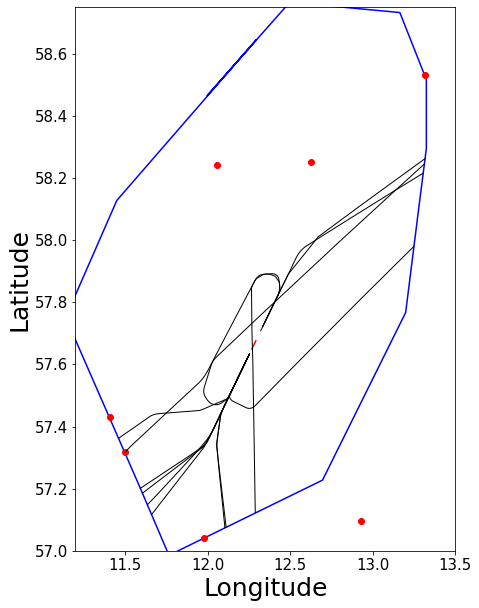

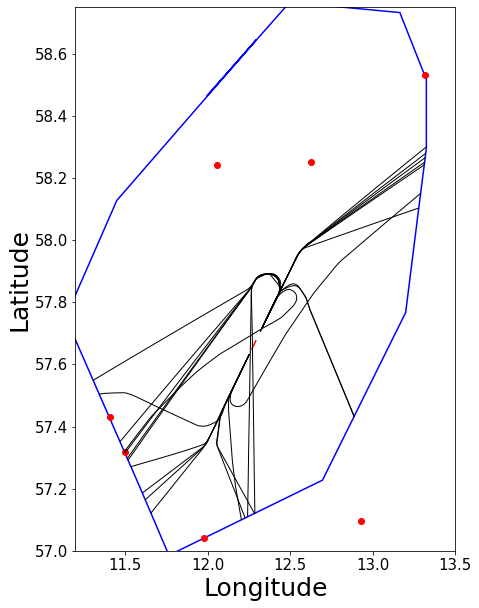

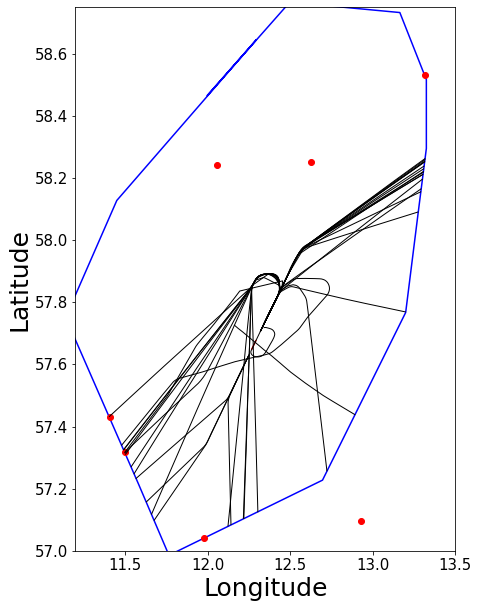

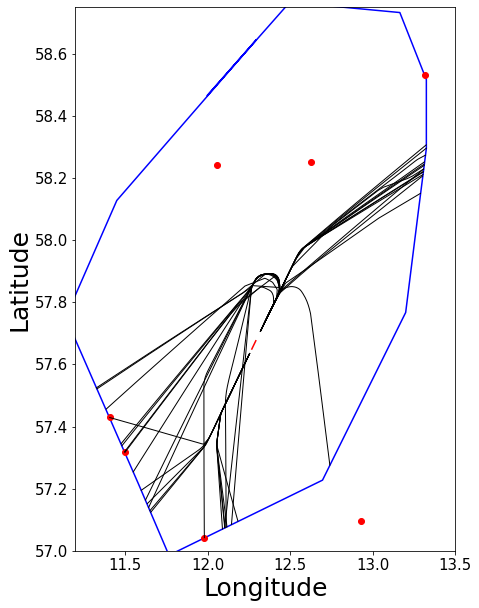

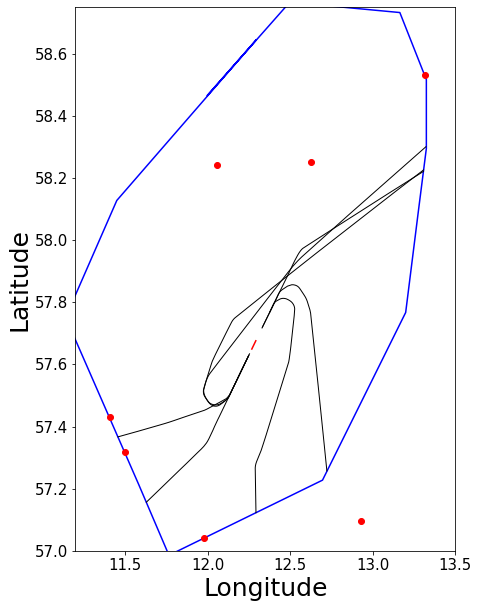

In [38]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_05_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_05_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_05_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_05_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_05_5.png")

In [39]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_06_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_06_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_06_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_06_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_06_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

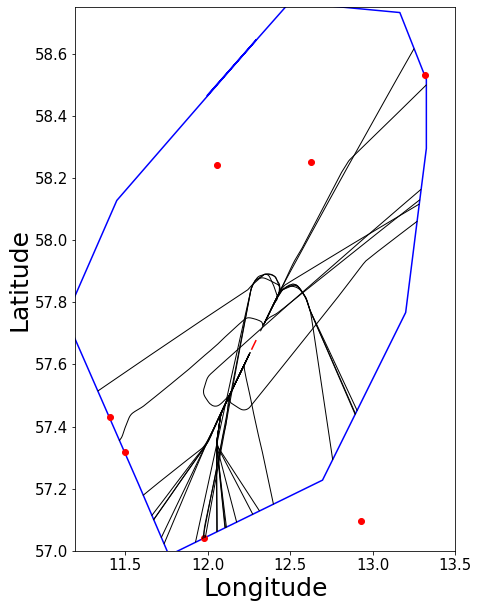

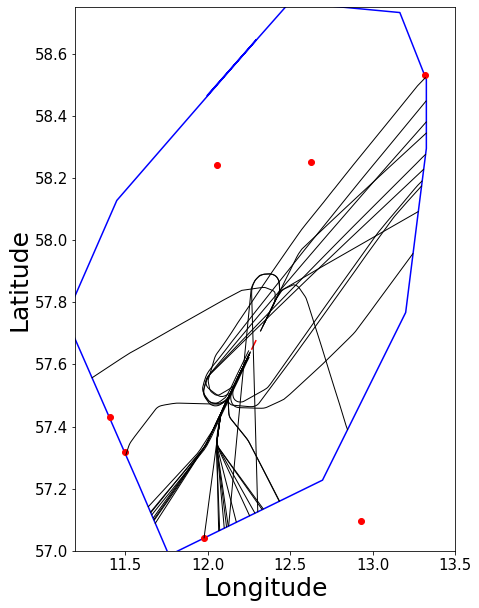

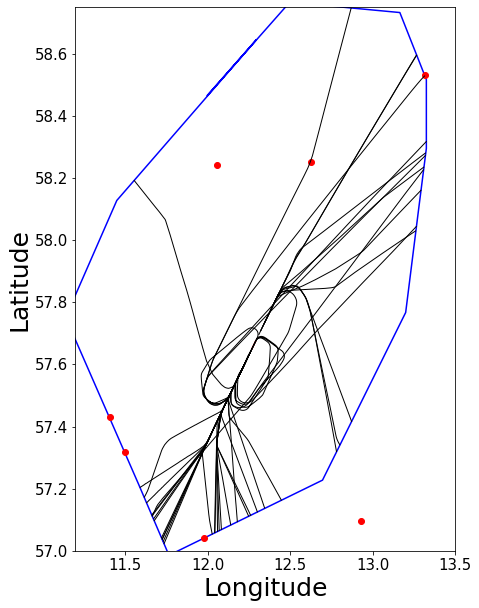

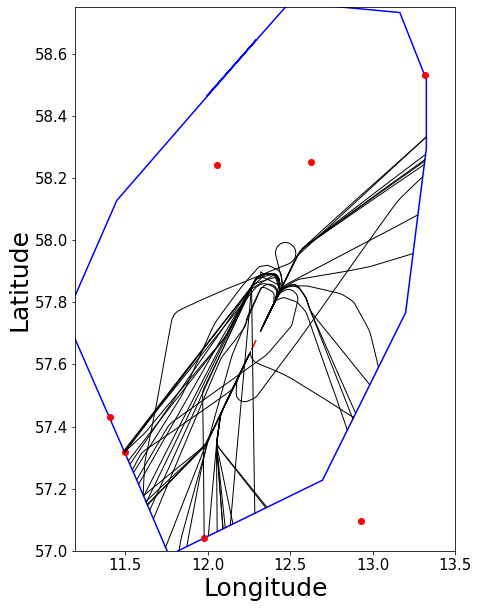

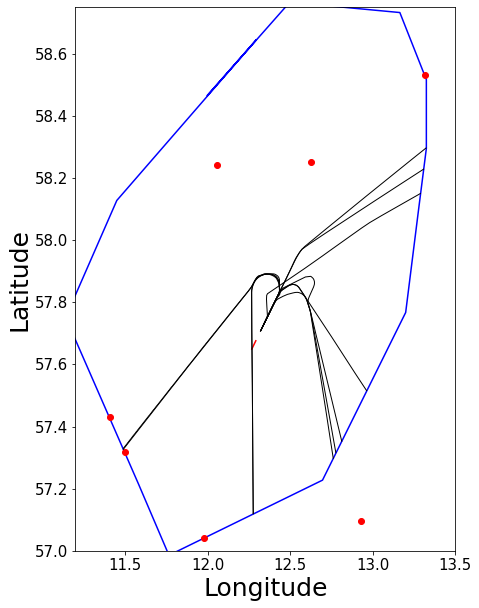

In [40]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_06_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_06_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_06_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_06_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_06_5.png")

In [41]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_07_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_07_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_07_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_07_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_07_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

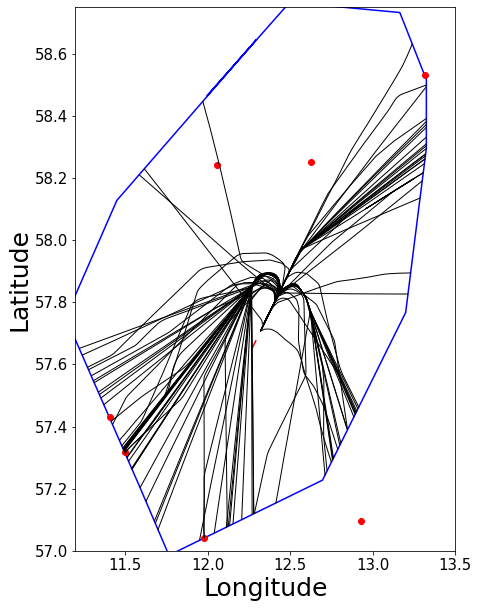

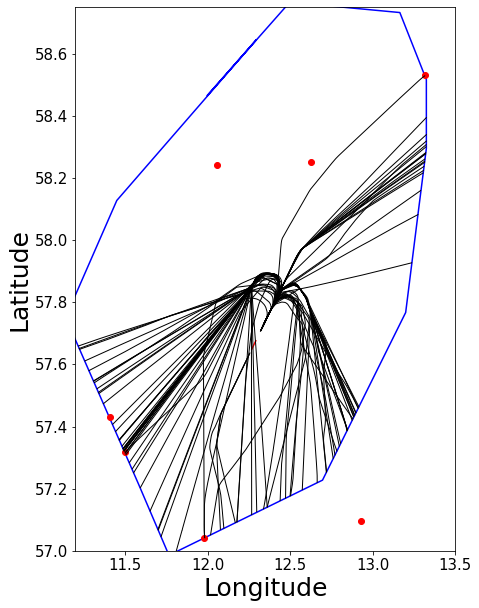

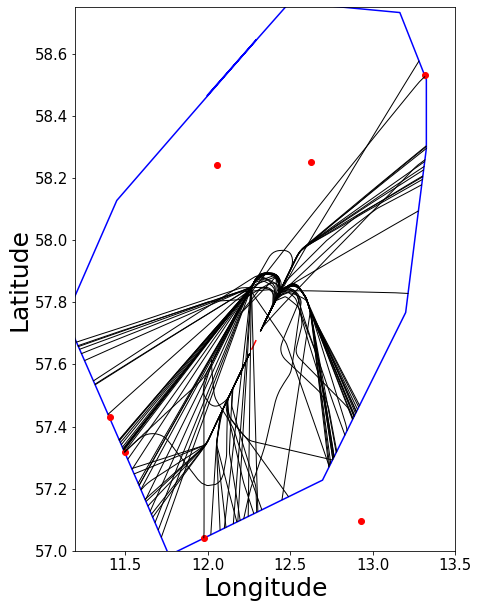

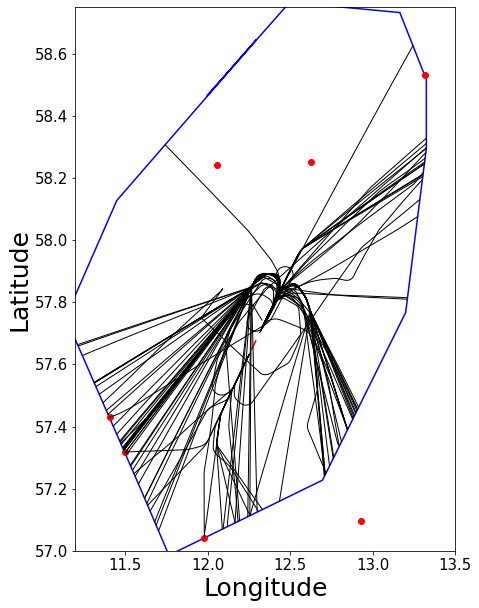

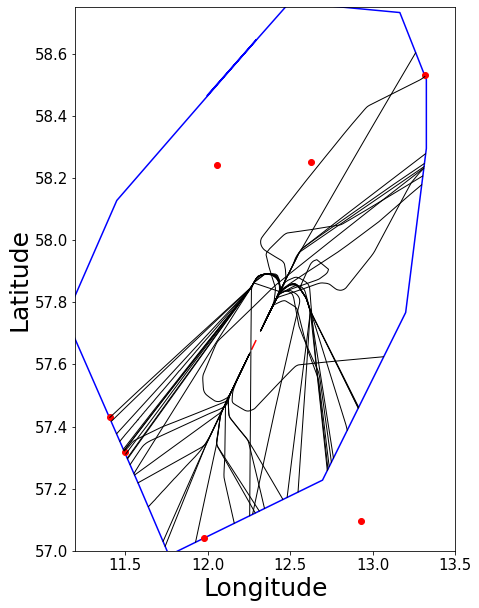

In [42]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_07_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_07_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_07_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_07_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_07_5.png")

In [43]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_08_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_08_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_08_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_08_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_08_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

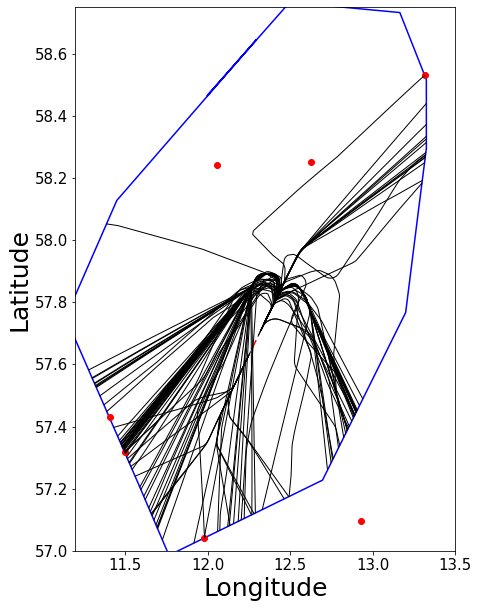

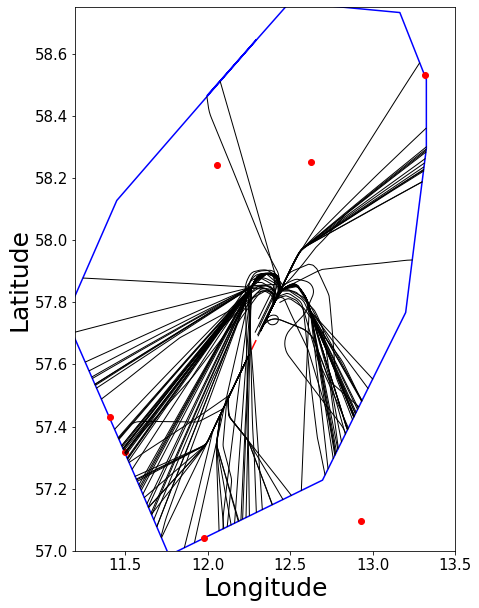

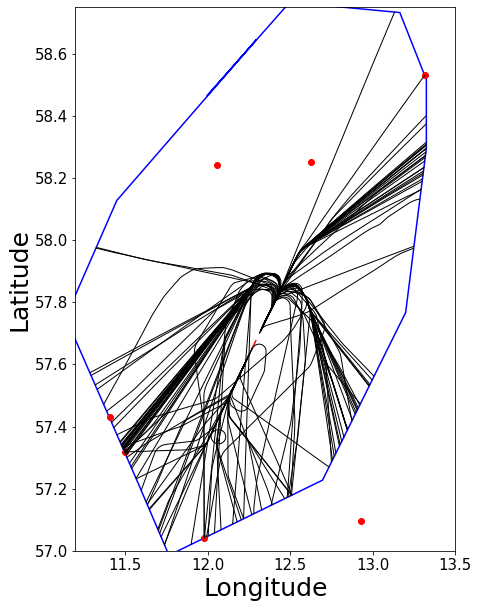

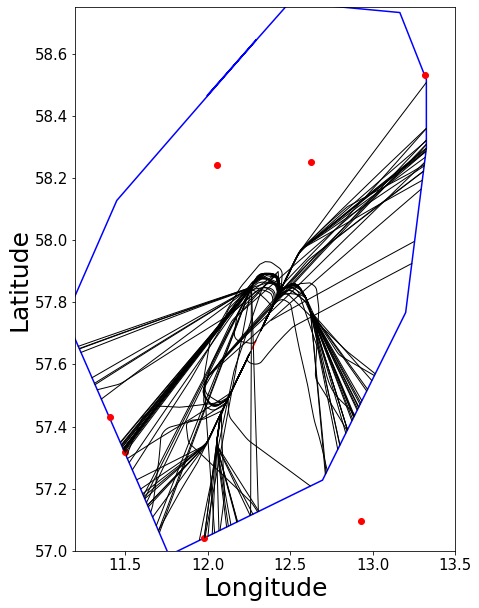

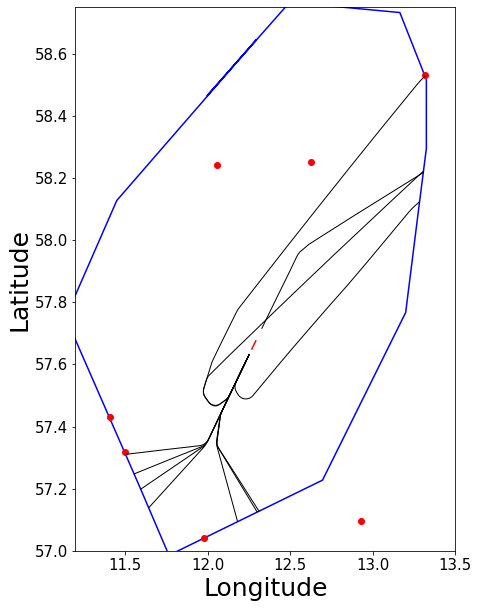

In [44]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_08_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_08_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_08_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_08_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_08_5.png")

In [45]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_09_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_09_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_09_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_09_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_09_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

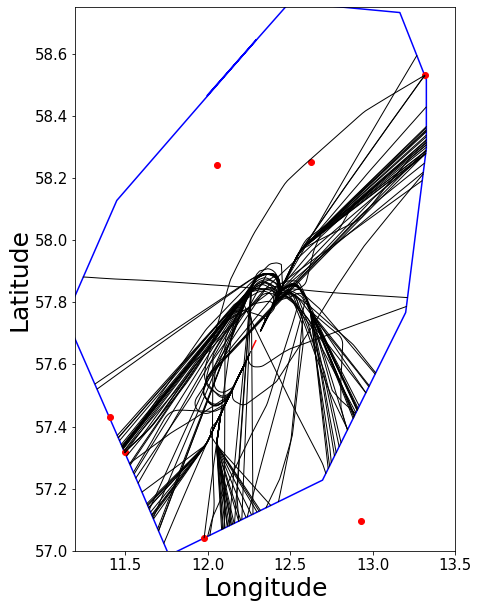

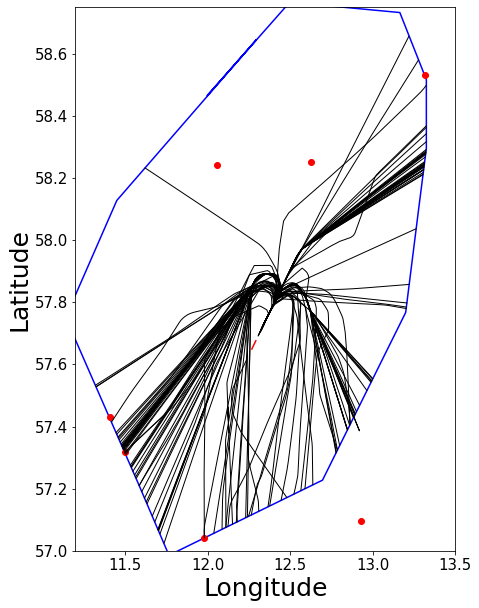

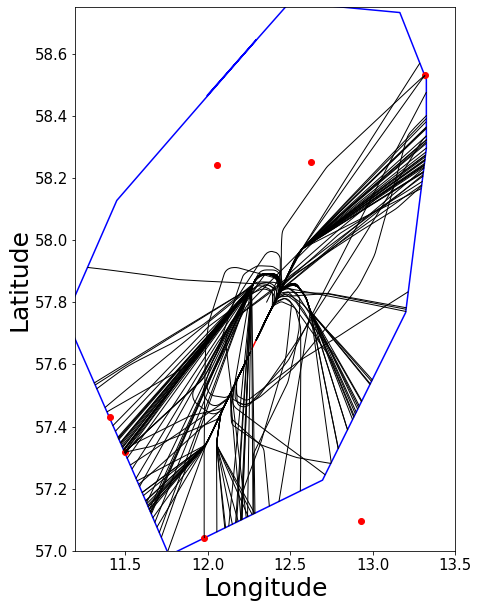

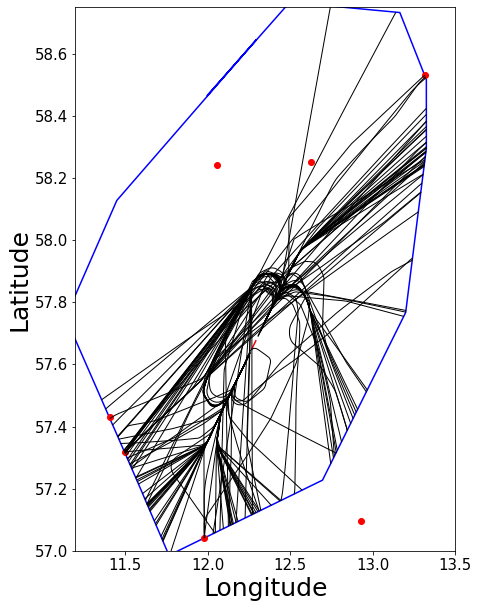

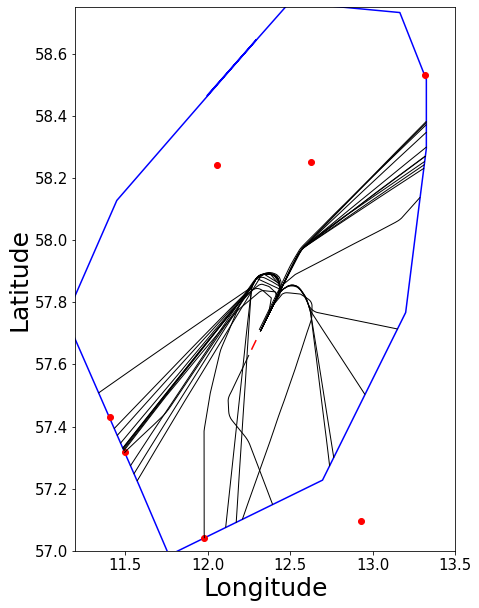

In [46]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_09_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_09_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_09_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_09_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_09_5.png")

In [47]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_10_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_10_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_10_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_10_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_10_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

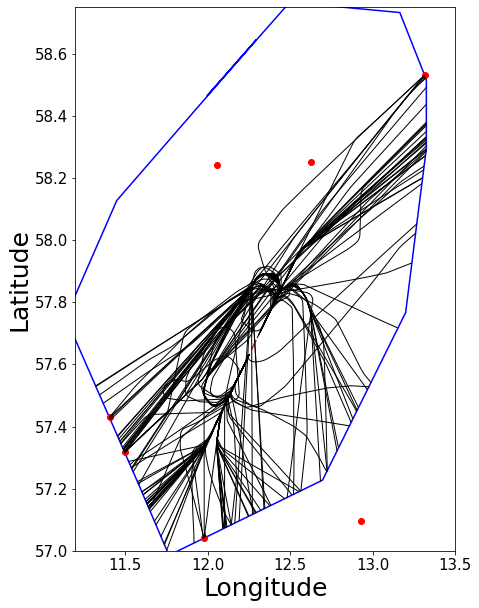

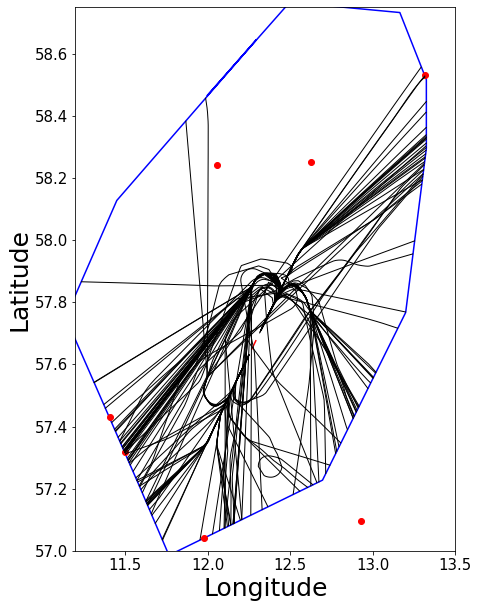

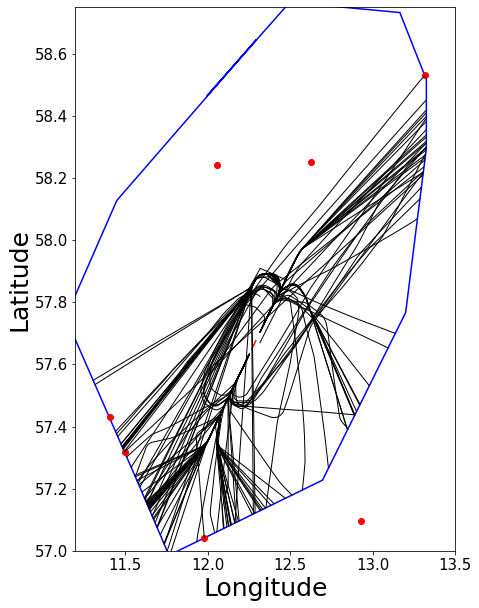

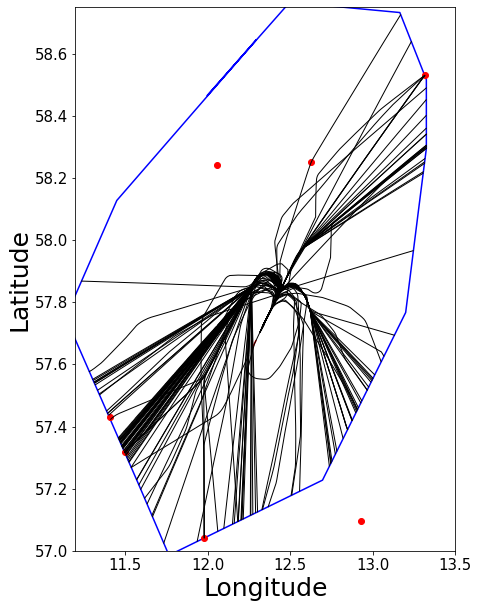

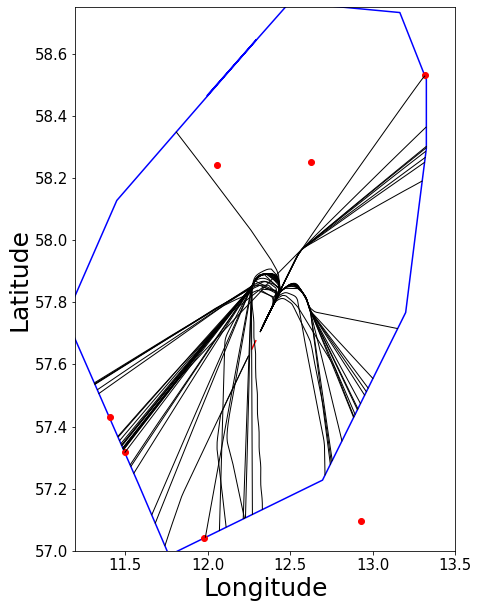

In [48]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_10_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_10_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_10_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_10_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_10_5.png")

In [49]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_11_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_11_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_11_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_11_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_11_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

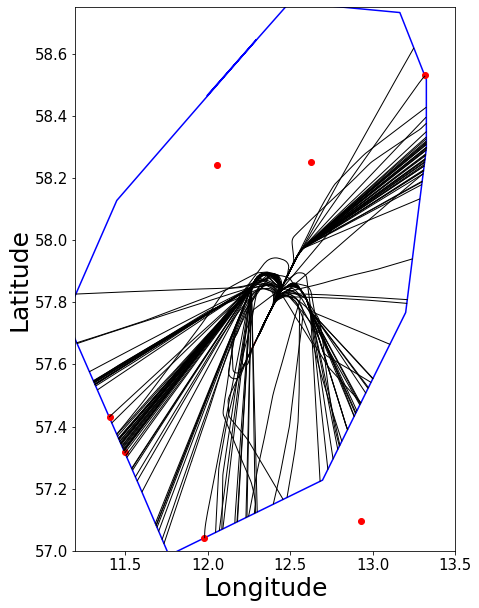

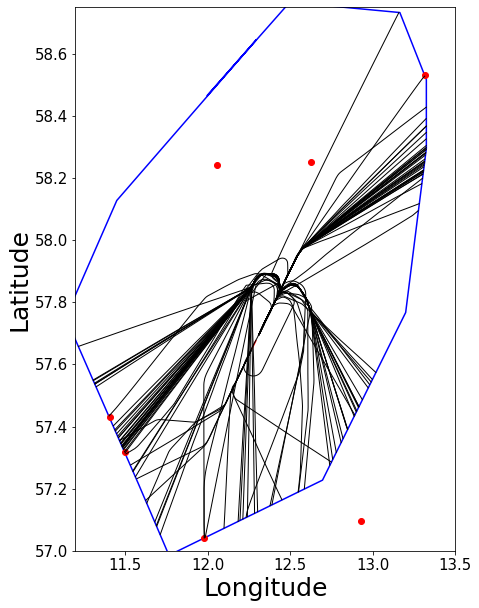

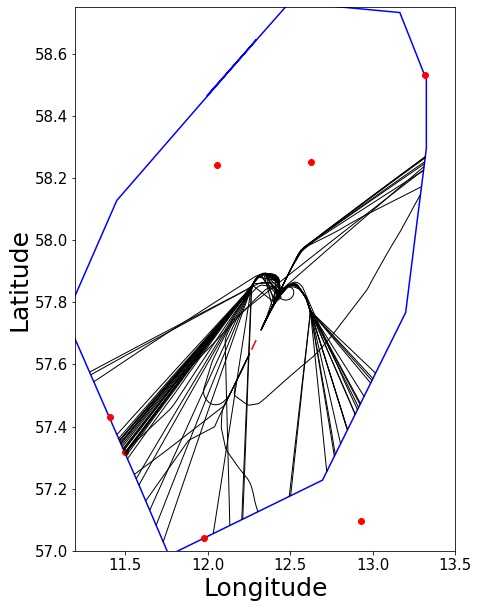

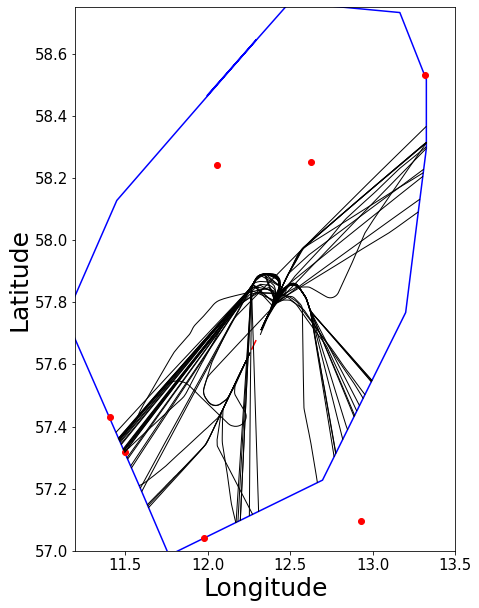

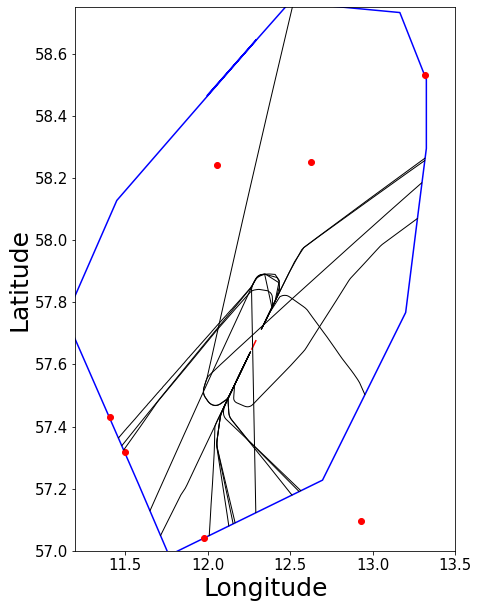

In [50]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_11_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_11_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_11_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_11_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_11_5.png")

In [51]:
filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_12_week1.csv"
temp1_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp1_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_12_week2.csv"
temp2_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp2_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_12_week3.csv"
temp3_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp3_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_12_week4.csv"
temp4_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp4_df.set_index(['flightId', 'sequence'], inplace = True)

filename = "../Data/ESGG/2020/osn_ESGG_states_TMA_2020/osn_arrival_ESGG_states_TMA_2020_12_week5.csv"
temp5_df = pd.read_csv(filename, sep=' ',
    names = ['flightId', 'sequence', 'timestamp', 'lat', 'lon', 'rawAltitude', 'altitude', 'velocity', 'beginDate', 'endDate'])
temp5_df.set_index(['flightId', 'sequence'], inplace = True)

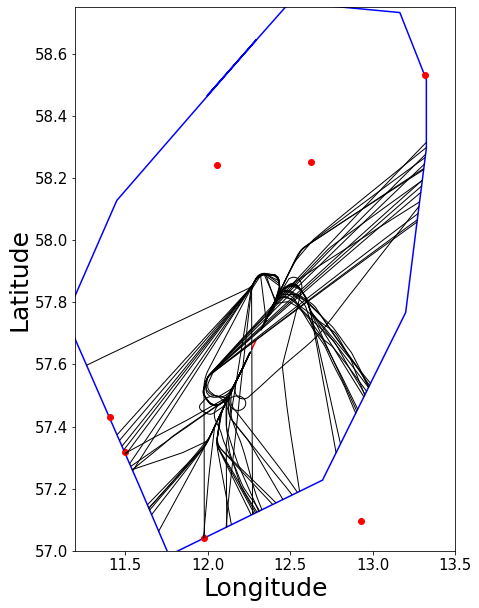

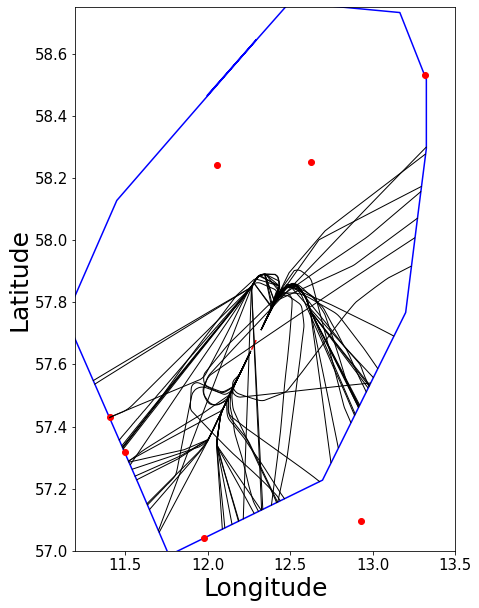

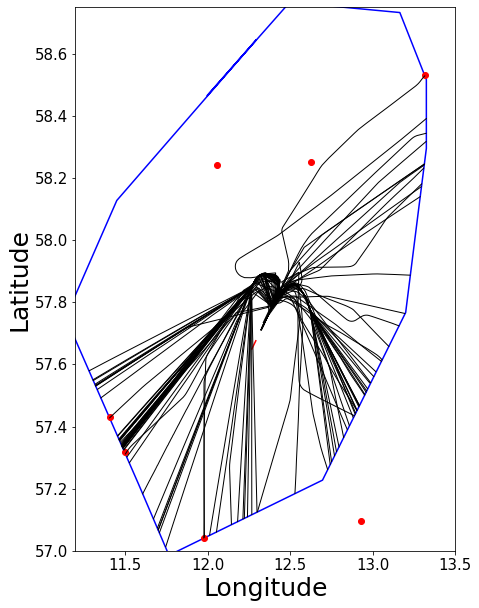

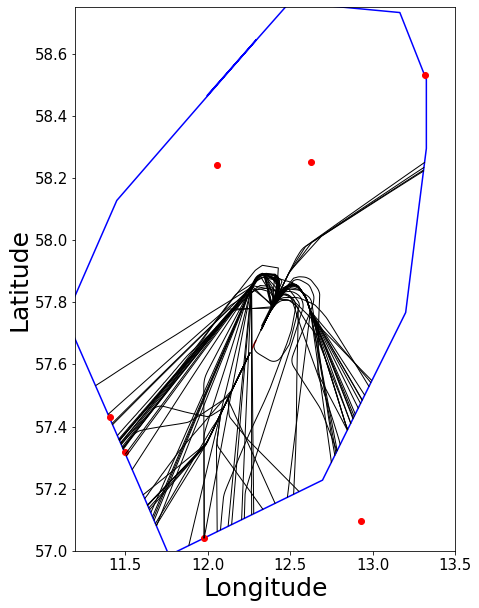

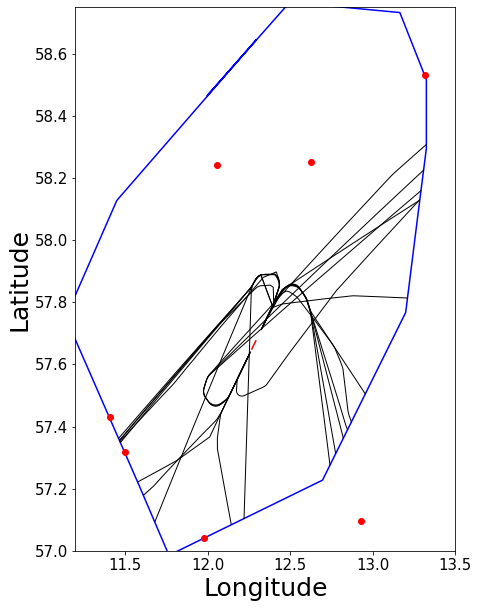

In [52]:
plot_horizontal_profile(temp1_df)
plt.savefig("Figures/ESGG_2020_12_1.png")
plot_horizontal_profile(temp2_df)
plt.savefig("Figures/ESGG_2020_12_2.png")
plot_horizontal_profile(temp3_df)
plt.savefig("Figures/ESGG_2020_12_3.png")
plot_horizontal_profile(temp4_df)
plt.savefig("Figures/ESGG_2020_12_4.png")
plot_horizontal_profile(temp5_df)
plt.savefig("Figures/ESGG_2020_12_5.png")